In [1]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
import skimage.io
import os
import shutil
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from textwrap import wrap
%matplotlib inline

In [9]:
STAGE1_TRAIN = "../stage/stage1_train"# Your training file address
STAGE1_TRAIN_IMAGE_PATTERN = "%s/{}/images/{}.png" % STAGE1_TRAIN
STAGE1_TRAIN_MASK_PATTERN = "%s/{}/masks/*.png" % STAGE1_TRAIN
IMAGE_ID = "image_id"
IMAGE_WIDTH = "width"
IMAGE_WEIGHT = "height"
HSV_CLUSTER = "hsv_cluster"
HSV_DOMINANT = "hsv_dominant"
TOTAL_MASK = "total_masks"

In [10]:
def image_ids_in(root_dir, ignore=[]):
    ids = []
    for id in os.listdir(root_dir):
        if id in ignore:
            print('Skipping ID:', id)
        else:
            ids.append(id)
    return ids

In [11]:
def read_image(image_id, space="rgb"):
    image_file = STAGE1_TRAIN_IMAGE_PATTERN.format(image_id, image_id)
    image = skimage.io.imread(image_file)
    # alpha 
    image = image[:, :, :3]
    if space == "hsv":
        image = skimage.color.rgb2hsv(image)
    return image

In [12]:
def read_image_labels(image_id, space="rgb"):
    image = read_image(image_id, space = space)
    mask_file = STAGE1_TRAIN_MASK_PATTERN.format(image_id)
    masks = skimage.io.imread_collection(mask_file).concatenate()    
    height, width, _ = image.shape
    num_masks = masks.shape[0]
    labels = np.zeros((height, width), np.uint16)
    for index in range(0, num_masks):
        labels[masks[index] > 0] = 255 
    return image, labels, num_masks

In [13]:
train_image_ids = image_ids_in(STAGE1_TRAIN)

In [14]:
def get_domimant_colors(img, top_colors=2):
    img_l = img.reshape((img.shape[0] * img.shape[1], img.shape[2]))
    clt = KMeans(n_clusters = top_colors)
    clt.fit(img_l)
    numLabels = np.arange(0, len(np.unique(clt.labels_)) + 1)
    (hist, _) = np.histogram(clt.labels_, bins = numLabels)
    hist = hist.astype("float")
    hist /= hist.sum()
    return clt.cluster_centers_, hist

In [15]:
def get_images_details(image_ids):
    details = []
    for image_id in image_ids:
        image_hsv, labels, num_masks = read_image_labels(image_id, space="hsv")
        height, width, l = image_hsv.shape
        dominant_colors_hsv, dominant_rates_hsv = get_domimant_colors(image_hsv, top_colors=1)
        dominant_colors_hsv = dominant_colors_hsv.reshape(1, dominant_colors_hsv.shape[0] * dominant_colors_hsv.shape[1])
        info = (image_id, width, height, num_masks, dominant_colors_hsv.squeeze())
        details.append(info)
    return details

In [16]:
META_COLS = [IMAGE_ID, IMAGE_WIDTH, IMAGE_WEIGHT, TOTAL_MASK]
COLS = META_COLS + [HSV_DOMINANT]

In [ ]:
details = get_images_details(train_image_ids)

In [ ]:
trainPD = pd.DataFrame(details, columns=COLS)
X = (pd.DataFrame(trainPD[HSV_DOMINANT].values.tolist())).as_matrix()
kmeans = KMeans(n_clusters=3).fit(X)
clusters = kmeans.predict(X)
trainPD[HSV_CLUSTER] = clusters

In [ ]:
trainPD.head()

In [ ]:
def plot_images(images, images_rows, images_cols):
    f, axarr = plt.subplots(images_rows,images_cols,figsize=(16,images_rows*2))
    for row in range(images_rows):
        for col in range(images_cols):
            image_id = images[row*images_cols + col]
            image = read_image(image_id)
            height, width, l = image.shape
            ax = axarr[row,col]
            ax.axis('off')
            ax.set_title("%dx%d"%(width, height))
            ax.imshow(image)

In [ ]:
plot_images(trainPD[trainPD[HSV_CLUSTER] == 0][IMAGE_ID].values, 70, 8)

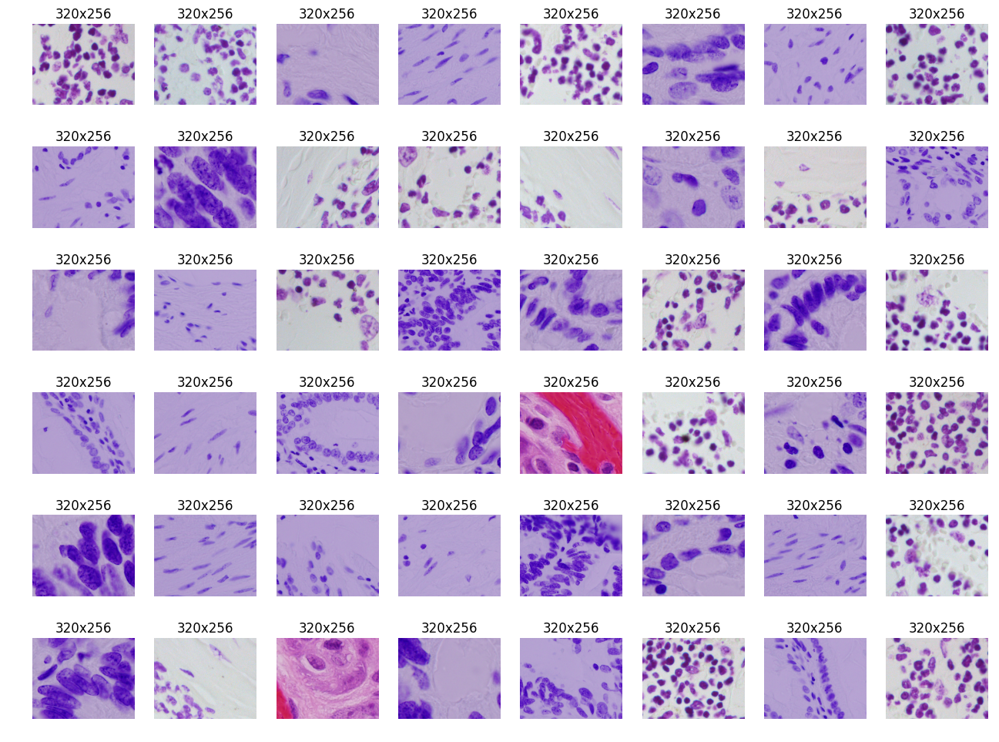

In [17]:
plot_images(trainPD[trainPD[HSV_CLUSTER] == 1][IMAGE_ID].values, 6, 8)

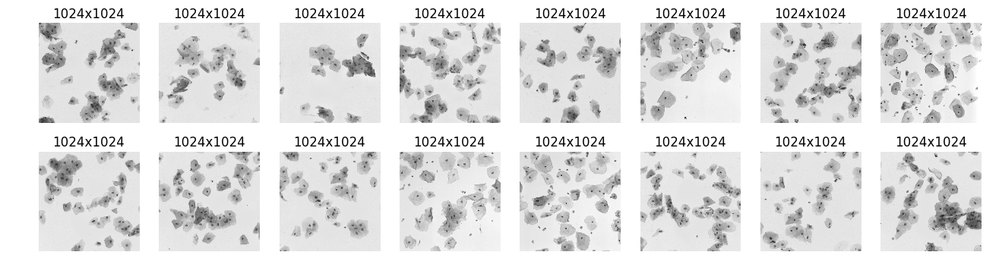

In [18]:
plot_images(trainPD[trainPD[HSV_CLUSTER] == 2][IMAGE_ID].values, 2, 8)

In [ ]:
P = trainPD.groupby(HSV_CLUSTER)[IMAGE_ID].count().reset_index()
P['Percentage'] = 100*P[IMAGE_ID]/P[IMAGE_ID].sum()
P

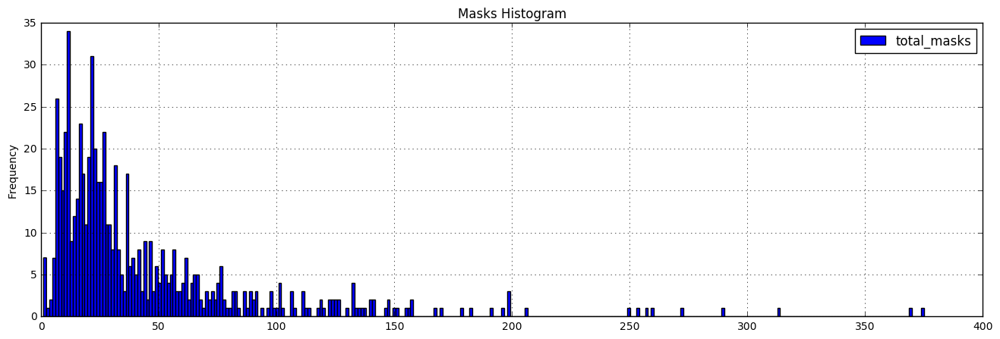

In [20]:
f, ax = plt.subplots(1,1,figsize=(16,5))
r = trainPD.plot(kind="hist", bins=300, y = TOTAL_MASK, ax=ax, grid=True, title="Masks Histogram")

In [21]:
import os
import sys
import random
import warnings

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

from tqdm import tqdm
from itertools import chain
from skimage.io import imread, imshow, imread_collection, concatenate_images
from skimage.transform import resize
from skimage.morphology import label

from keras.models import Model, load_model
from keras.layers import Input
from keras.layers.core import Dropout, Lambda
from keras.layers.convolutional import Conv2D, Conv2DTranspose
from keras.layers.pooling import MaxPooling2D
from keras.layers.merge import concatenate
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras import backend as K
from skimage import transform

import tensorflow as tf

#  some parameters
IMG_WIDTH = 256
IMG_HEIGHT = 256
IMG_CHANNELS = 1
TRAIN_PATH = '../stage/stage1_train/' 
TEST_PATH = '../stage/stage1_test/'

warnings.filterwarnings('ignore', category=UserWarning, module='skimage')
seed = 42
random.seed = seed
np.random.seed = seed

Using TensorFlow backend.


In [ ]:
T_PATH = '../stage/t/'
test_it = next(os.walk(T_PATH))[1] #load a image to test

In [12]:
X_t = np.zeros((len(test_it), IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS), dtype=np.uint8)
sizes_t = []
print('Getting and resizing test images ... ')
sys.stdout.flush()
for n, id_ in tqdm(enumerate(test_it), total=len(test_it)):
    path = T_PATH + id_
    img = imread(path + '/' + id_ + '.png')[:,:,:IMG_CHANNELS]
    img = resize(img, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
    X_t[n] = img

print('Done!')

Getting and resizing test images ... 


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 12.85it/s]


Done!


In [15]:
T_P = '../stage/q/'

[array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8), array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8), array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8), array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8), array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0

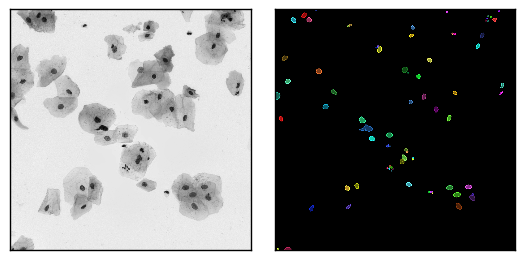

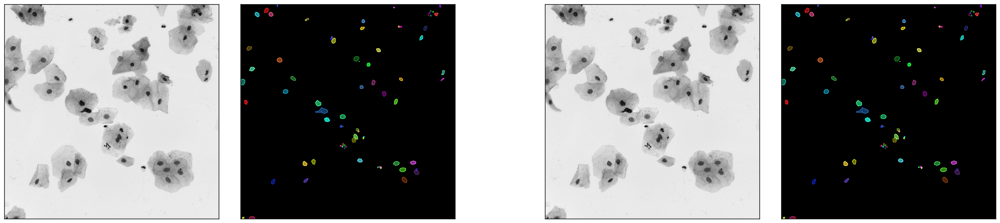

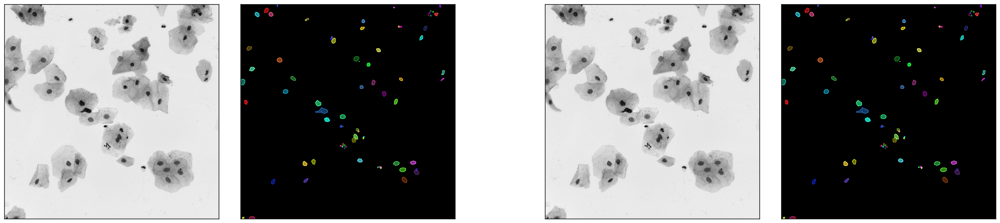

In [25]:
FIG_SIZE = (20, 30)
import math
import itertools
import os
import numpy as np
import skimage.io as io
import pandas as pd
from scipy import ndimage
import matplotlib
from matplotlib import pyplot as plt
from matplotlib import gridspec
%matplotlib inline
import warnings
warnings.filterwarnings('ignore', category=UserWarning, module='skimage')
def hsv_to_rgb(h, s, v):
    h -= math.floor(h)
    h = h * 6
    if h < 1:
        [r, g, b] = [1, h, 0]
    elif h < 2:
        [r, g, b] = [2 - h, 1, 0]
    elif h < 3:
        [r, g, b] = [0, 1, h - 2]
    elif h < 4:
        [r, g, b] = [0, 4 - h, 1]
    elif h < 5:
        [r, g, b] = [h - 4, 0, 1]
    else:
        [r, g, b] = [1, 0, 6 - h]
    return [((r - 0.5) * s + 0.5) * v, ((g - 0.5) * s + 0.5) * v, ((b - 0.5) * s + 0.5) * v]

hash_colorize = np.array([[0, 0, 0] if i == 0 else
                              hsv_to_rgb(((i + 1) % 17)/17,
                                         ((i + 1) % 3)/3 / 2 + 0.5,
                                         ((i + 1) % 5)/5 * 2/3 + 1/3)
                          for i in range(256)])

def mask_to_edges(mask):
    mask_edges = np.zeros(mask.shape).astype(np.uint8)
    for ii in range(1, mask.max() + 1):
        submask = mask.copy()
        submask[submask != ii] = 0
        submask[submask == ii] = 1
        submask_edges = submask - ndimage.binary_erosion(submask, structure=np.ones((5,5)))
        mask_edges += submask_edges * ii
    return mask_edges

def visualize_mask(mask, img=None, edges=True, fill=True):
    if fill:
        if img is None:
            img = mask.copy()
            img[img > 0] = 1
        img = np.multiply(np.repeat(np.reshape(img, img.shape + (1,)), 3, 2), hash_colorize[mask])
    else:
        if img is None:
            img = np.zeros(mask.shape)
        img = np.repeat(np.reshape(img, img.shape + (1,)), 3, 2)
    if edges:
        img = np.clip(img + hash_colorize[mask_to_edges(mask)], 0, 1)
    return img
def remove_alpha(img):
    return img[:, :, 0:3]

def grayscale(img):
    if img.shape[2] == 4:
        img = remove_alpha(img)
    return img.mean(axis=2)

def normalize(img):
    if len(img.shape) == 3 and img.shape[2] == 4:
        img = remove_alpha(img)
    img_max = img.max()
    img_min = img.min()
    img = (img - img_min) / (img_max - img_min)
    return img

def flatten_masks(masks):
    mask = np.zeros(masks[0].shape).astype(np.uint8)
    for ii, submask in enumerate(masks, 1):
        submask[submask > 0] = 1
        mask += submask * ii
    return mask

class NucleiDataset():
    def __init__(self, path, transform = None):
        self.path = path
        self.transform = transform
        self.ids = next(os.walk(path))[1]

    def __len__(self):
        return len(self.ids)
    
    def __getitem__(self, idx):
        id = self.ids[idx]
        return self.get(id)
    
    def get(self, id):
        path = self.path + id
        image = io.imread(path + "/images/" + id + ".png")
        masks = []
        mask_path = path + "/masks/"
        for mask in next(os.walk(mask_path))[2]:
            masks.append(io.imread(mask_path + mask))
            
        sample = {"id": id, "image": image, "masks": masks}
        if self.transform:
            self.transform(sample)
        return sample        

def normalize_and_flatten(sample):
    sample["image"] = normalize(grayscale(sample["image"]))
    sample["mask"] = flatten_masks(sample["masks"])
    del sample["masks"]

train_set = NucleiDataset(T_P)
test_set = NucleiDataset(TEST_PATH)
def plot_image(fig, sample, plot_spec):
    image = sample["image"]

    inner = gridspec.GridSpecFromSubplotSpec(1, 2,
                    subplot_spec=plot_spec, wspace=0.1, hspace=0.1)
    for j in range(2):
        ax = plt.Subplot(fig, inner[j])
        if j == 0:
            ax.imshow(normalize(image))
        else:
            ax.imshow(visualize_mask(flatten_masks(sample["masks"])))
            print(sample["masks"])
        ax.set_xticks([])
        ax.set_yticks([])
        fig.add_subplot(ax)
fig = plt.figure(figsize=(FIG_SIZE[1], FIG_SIZE[1]))
outer = gridspec.GridSpec(8, 4, wspace=0.2, hspace=0.2)

for (i, sample) in enumerate(itertools.islice(train_set, 32)):
    plot_image(fig, sample, outer[i])
image_ids = []
image_sizes = []
for sample in train_set:
    image = sample["image"]
    image_ids.append(sample["id"])
    image_sizes.append([image.shape[1], image.shape[0]])
image_ids = np.array(image_ids)
image_sizes = np.array(image_sizes)
images = np.rec.fromarrays((image_ids, image_sizes[:, 0], image_sizes[:, 1]),
                           dtype=[('id', image_ids.dtype), ('w', int), ('h', int)])
pd.DataFrame.from_records(images, index=('id'))
print("Range: (%d - %d) x (%d - %d)" % (images.w.min(), images.w.max(), images.h.min(), images.h.max()))
print("Mean: %d x %d" % (images.w.mean(), images.h.mean()))
aspect_ratio = images.w / images.h
def aspect_ratio_to_str(ratio):
    if ratio >= 1:
        return "%f : 1" % (ratio,)
    else:
        return "1 : %f" % (1 / ratio,)
print("Aspect ratio range: (%s) - (%s)" % (aspect_ratio_to_str(aspect_ratio.min()), aspect_ratio_to_str(aspect_ratio.max())))
fig = plt.figure(figsize=(FIG_SIZE[1], FIG_SIZE[1]))
outer = gridspec.GridSpec(1, 2, wspace=0.2, hspace=0.2)

smallest_image = images[(images.w * images.h).argmin()]
biggest_image = images[(images.w * images.h).argmax()]

plot_image(fig, train_set.get(smallest_image.id), outer[0])
plot_image(fig, train_set.get(biggest_image.id), outer[1])
fig = plt.figure(figsize=(FIG_SIZE[1], FIG_SIZE[1]))
outer = gridspec.GridSpec(1, 2, wspace=0.2, hspace=0.2)

lowest_aspect_image = images[(images.w / images.h).argmin()]
highest_aspect_image = images[(images.w / images.h).argmax()]

plot_image(fig, train_set.get(lowest_aspect_image.id), outer[0])
plot_image(fig, train_set.get(highest_aspect_image.id), outer[1])

In [ ]:
print(trainPD[trainPD[HSV_CLUSTER] == 2][IMAGE_ID].values)
train_ids = trainPD[trainPD[HSV_CLUSTER] == 0][IMAGE_ID].values
test_ids = next(os.walk(TEST_PATH))[1]

In [ ]:
# Get and resize train images and masks
X_train = np.zeros((len(train_ids), IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS), dtype=np.uint8)
Y_train = np.zeros((len(train_ids), IMG_HEIGHT, IMG_WIDTH, 1), dtype=np.bool)
print('Getting and resizing train images and masks ... ')
sys.stdout.flush()
for n, id_ in tqdm(enumerate(train_ids), total=len(train_ids)):
    path = TRAIN_PATH + id_
    img = imread(path + '/images/' + id_ + '.png')[:,:,:IMG_CHANNELS]
    img = resize(img, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
    X_train[n] = img
    mask = np.zeros((IMG_HEIGHT, IMG_WIDTH, 1), dtype=np.bool)
    for mask_file in next(os.walk(path + '/masks/'))[2]:
        mask_ = imread(path + '/masks/' + mask_file)
        mask_ = np.expand_dims(resize(mask_, (IMG_HEIGHT, IMG_WIDTH), mode='constant', 
                                      preserve_range=True), axis=-1)
        mask = np.maximum(mask, mask_)
    Y_train[n] = mask


X_test = np.zeros((len(test_ids), IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS), dtype=np.uint8)
sizes_test = []
print('Getting and resizing test images ... ')
sys.stdout.flush()
for n, id_ in tqdm(enumerate(test_ids), total=len(test_ids)):
    path = TEST_PATH + id_
    img = imread(path + '/images/' + id_ + '.png')[:,:,:IMG_CHANNELS]
    sizes_test.append([img.shape[0], img.shape[1]])
    img = resize(img, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
    X_test[n] = img

print('Done!')

In [17]:
train_idss = trainPD[trainPD[HSV_CLUSTER] == 1][IMAGE_ID].values
print(train_idss)

['00071198d059ba7f5914a526d124d28e6d010c92466da21d4a04cd5413362552'
 '003cee89357d9fe13516167fd67b609a164651b21934585648c740d2c3d86dc1'
 '0280fa8f60f6bcae0f97d93c28f60be194f9309ff610dc5845e60455b0f87c21'
 '0287e7ee5b007c91ae2bd7628d09735e70496bc6127ecb7f3dd043e04ce37426'
 '02903040e19ddf92f452907644ad3822918f54af41dd85e5a3fe3e1b6d6f9339'
 '03398329ced0c23b9ac3fac84dd53a87d9ffe4d9d10f1b5fe8df8fac12380776'
 '03b9306f44e9b8951461623dcbd615550cdcf36ea93b203f2c8fa58ed1dffcbe'
 '03f583ec5018739f4abb9b3b4a580ac43bd933c4337ad8877aa18b1dfb59fc9a'
 '0402a81e75262469925ea893b6706183832e85324f7b1e08e634129f5d522cdd'
 '04acab7636c4cf61d288a5962f15fa456b7bde31a021e5deedfbf51288e4001e'
 '05040e2e959c3f5632558fc9683fec88f0010026c555b499066346f67fdd0e13'
 '0532c64c2fd0c4d3188cc751cdfd566b1cfba3d269358717295bab1504c7c275'
 '05a8f65ebd0b30d3b210f30b4d640c847c2e710d0d135e0aeeaccbe1988e3b6e'
 '06350c7cc618be442c15706db7a68e91f313758d224de4608f9b960106d4f9ca'
 '06c779330d6d3447be21df2b9f05d1088f5b3b50dc4872

In [18]:
# Get and resize train images and masks
X_trainn = np.zeros((len(train_idss), IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS), dtype=np.uint8)
Y_trainn = np.zeros((len(train_idss), IMG_HEIGHT, IMG_WIDTH, 1), dtype=np.bool)
print('Getting and resizing train images and masks ... ')
sys.stdout.flush()
for n, id_ in tqdm(enumerate(train_idss), total=len(train_idss)):
    path = TRAIN_PATH + id_
    img = imread(path + '/images/' + id_ + '.png')[:,:,:IMG_CHANNELS]
    img = resize(img, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
    X_trainn[n] = img
    mask = np.zeros((IMG_HEIGHT, IMG_WIDTH, 1), dtype=np.bool)
    for mask_file in next(os.walk(path + '/masks/'))[2]:
        mask_ = imread(path + '/masks/' + mask_file)
        mask_ = np.expand_dims(resize(mask_, (IMG_HEIGHT, IMG_WIDTH), mode='constant', 
                                      preserve_range=True), axis=-1)
        mask = np.maximum(mask, mask_)
    Y_trainn[n] = mask

Getting and resizing train images and masks ... 


100%|████████████████████████████████████████████████████████████████████████████████| 546/546 [02:20<00:00,  3.88it/s]


In [19]:
train_idsss = trainPD[trainPD[HSV_CLUSTER] == 2][IMAGE_ID].values

In [20]:
# Get and resize train images and masks
X_trainnn = np.zeros((len(train_idsss), IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS), dtype=np.uint8)
Y_trainnn = np.zeros((len(train_idsss), IMG_HEIGHT, IMG_WIDTH, 1), dtype=np.bool)
print('Getting and resizing train images and masks ... ')
sys.stdout.flush()
for n, id_ in tqdm(enumerate(train_idsss), total=len(train_idsss)):
    path = TRAIN_PATH + id_
    img = imread(path + '/images/' + id_ + '.png')[:,:,:IMG_CHANNELS]
    img = resize(img, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
    X_trainnn[n] = img
    mask = np.zeros((IMG_HEIGHT, IMG_WIDTH, 1), dtype=np.bool)
    for mask_file in next(os.walk(path + '/masks/'))[2]:
        mask_ = imread(path + '/masks/' + mask_file)
        mask_ = np.expand_dims(resize(mask_, (IMG_HEIGHT, IMG_WIDTH), mode='constant', 
                                      preserve_range=True), axis=-1)
        mask = np.maximum(mask, mask_)
    Y_trainnn[n] = mask

Getting and resizing train images and masks ... 


100%|██████████████████████████████████████████████████████████████████████████████████| 16/16 [00:18<00:00,  1.18s/it]


D:\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and


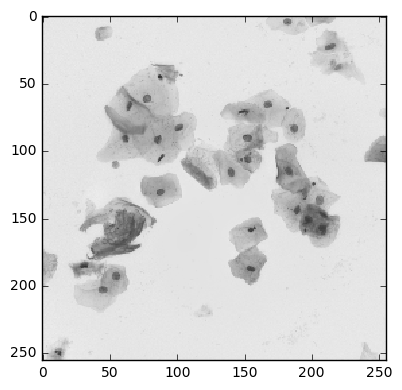

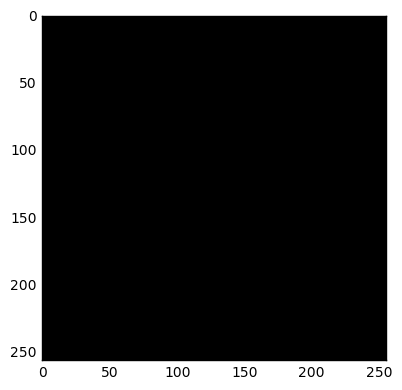

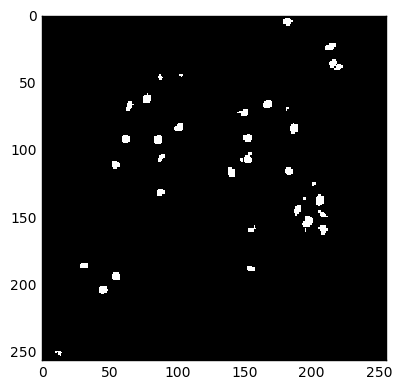

<class 'numpy.ndarray'>
[[[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 ...

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]]
<class 'numpy.ndarray'>
[[[231 231 231]
  [231 231 231]
  [232 232 232]
  ...
  [228 228 228]
  [232 232 232]
  [229 229 229]]

 [[229 229 229]
  [230 230 230]
  [231 231 231]
  ...
  [230 230 230]
  [228 228 228]
  [229 229 229]]

 [[231 231 231]
  [228 228 228]
  [230 230 230]
  ...
  [227 227 227]
  [232 232 232]
  [231 231 231]]

 ...

 [[238 238 238]
  [230 230 230]
  [230 230 230]
  ...
  [231 231 231]
  [232 232 232]
  [230 230 230]]

 [[234 234 234]
  [231 231 231]
  [227 227 227]
  ...
  [231 231 231]
  [230 230 230]
  [230 230 230]]

 [[236 236 2

In [32]:
imshow(X_trainnn[1])
plt.show()
qqq = X_trainnn[1]/255
qqq = qqq.astype(np.uint8)
imshow(qqq)
plt.show()
imshow(np.squeeze(Y_trainnn[1]))
plt.show()
print(type(X_trainnn[1]))
print(format(qqq))
print(type(X_trainnn[1]))
print(format(X_trainnn[1]))
print(type(Y_trainnn[1]))
print(format(Y_trainnn[1]))

In [ ]:
def plot_imagess(images, images_rows, images_cols):
    f, axarr = plt.subplots(images_rows,images_cols,figsize=(16,images_rows*2))
    for row in range(images_rows):
        for col in range(images_cols):
            image = images[row*images_cols + col]
            height, width, l = image.shape
            ax = axarr[row,col]
            ax.axis('off')
            ax.set_title("%dx%d"%(width, height))
            ax.imshow(np.squeeze(image))

In [ ]:
plot_imagess(X_train, 6, 8)

In [ ]:
plot_imagess(X_trainn, 6, 8)

In [ ]:
plot_imagess(X_trainnn, 2, 8)

In [7]:
# Define IoU metric
def mean_iou(y_true, y_pred):
    prec = []
    for t in np.arange(0.5, 1.0, 0.05):
        y_pred_ = tf.to_int32(y_pred > t)
        score, up_opt = tf.metrics.mean_iou(y_true, y_pred_, 2)
        K.get_session().run(tf.local_variables_initializer())
        with tf.control_dependencies([up_opt]):
            score = tf.identity(score)
        prec.append(score)
    return K.mean(K.stack(prec), axis=0)

In [8]:
from keras import backend as K
from keras.metrics import binary_crossentropy
from sklearn import preprocessing
smooth = 1.

def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)
def bce_dice(y_true, y_pred):
    return binary_crossentropy(y_true, y_pred)-K.log(dice_coef(y_true, y_pred))

In [ ]:
#S-FCN
from keras.layers import BatchNormalization
Build U-Net model
input1 = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
s = Lambda(lambda x: x / 255) (input1)

c1 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (s)
c1 = BatchNormalization() (c1)
c1 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c1)
p1 = MaxPooling2D((2, 2)) (c1)

c2 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p1)
c2 = BatchNormalization() (c2)
c2 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c2)
p2 = MaxPooling2D((2, 2)) (c2)

c3 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p2)
c3 = BatchNormalization() (c3)
c3 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c3)
p3 = MaxPooling2D((2, 2)) (c3)

c4 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p3)
c4 = BatchNormalization() (c4)
c4 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c4)
p4 = MaxPooling2D(pool_size=(2, 2)) (c4)

c5 = Conv2D(256, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p4)
c5 = BatchNormalization() (c5)
c5 = Conv2D(256, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c5)

u6 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same') (c5)
u6 = concatenate([u6, c4])
c6 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u6)
c6 = BatchNormalization() (c6)
c6 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c6)

u7 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same') (c6)
u7 = concatenate([u7, c3])
c7 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u7)
c7 = BatchNormalization() (c7)
c7 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c7)

u8 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same') (c7)
u8 = concatenate([u8, c2])
c8 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u8)
c8 = BatchNormalization() (c8)
c8 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c8)

u9 = Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same') (c8)
u9 = concatenate([u9, c1], axis=3)
c9 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u9)
c9 = BatchNormalization() (c9)
c9 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c9)

output1 = Conv2D(1, (1, 1), activation='sigmoid') (c9)

model = Model(inputs=[input1], outputs=[output1])
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=[bce_dice,dice_coef,mean_iou])
model.summary()
model = load_model('model-dsbowl2018-1.h5', custom_objects={'mean_iou': mean_iou,'bce_dice':bce_dice,'dice_coef':dice_coef})

In [ ]:
earlystopper = EarlyStopping(patience=5, verbose=1)
checkpointer = ModelCheckpoint('model-dsbowl2018-4.h5', verbose=1, save_best_only=True)
history = model.fit(X_train, Y_train, validation_split=0.1, batch_size=16, epochs=50, 
                    callbacks=[earlystopper,checkpointer])

In [ ]:
fig = plt.figure(figsize=(10,5))
plt.subplot(121)
plt.plot(history.history['loss'],'.--',color='#4EEE94')
plt.plot(history.history['val_loss'],'.--',color='#EEC900')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Cross Loss')
plt.legend(['train','test'], loc='upper left')
plt.grid(True)
# plt.show()
    # 准确率曲线marker='*'
plt.subplot(122)
plt.plot(history.history['mean_iou'],'.--',color='#FF6347')
plt.plot(history.history['val_mean_iou'],'.--',color='#6495ED')
plt.plot(history.history['val_dice_coef'],'.--',color='#98FB98')
plt.plot(history.history['val_bce_dice'],'.--',color='#DC143C')
plt.xlabel('Epochs')
plt.ylabel('mean_iou Rate')
plt.title('Train Accuracy Rate')
plt.legend(['train mean_iou','valid mean_iou','valid dice_coef','valid bce_dice'], loc='upper left')
plt.grid(True)
plt.show()

In [32]:
#DATA AU SPATIAL TRANS
import cv2

def get_more_images(imgs):
    
    more_images = []
    vert_flip_imgs = []
    hori_flip_imgs = []
    
    for i in range(0,imgs.shape[0]):
        a=imgs[i,:,:,0]
        b=imgs[i,:,:,1]
        c=imgs[i,:,:,2]
    
        av=cv2.flip(a,1)
        ah=cv2.flip(a,0)
        bv=cv2.flip(b,1)
        bh=cv2.flip(b,0)
        cv=cv2.flip(c,1)
        ch=cv2.flip(c,0)
    
        vert_flip_imgs.append(np.dstack((av, bv, cv)))
        hori_flip_imgs.append(np.dstack((ah, bh, ch)))
    
    v = np.array(vert_flip_imgs)
    h = np.array(hori_flip_imgs)
    
    more_images = np.concatenate((imgs,v,h))
    
    return more_images

def duplicate_labels(labels):
    more_images = []
    vert_flip_imgs = []
    hori_flip_imgs = []
    for i in range(0,labels.shape[0]):
        a=labels[i,:,:,0]
    
        av=cv2.flip(a,1)
        ah=cv2.flip(a,0)
        
        vert_flip_imgs.append(av.reshape(IMG_WIDTH,IMG_WIDTH,1))
        hori_flip_imgs.append(ah.reshape(IMG_WIDTH,IMG_WIDTH,1))
        
    v = np.array(vert_flip_imgs)
    h = np.array(hori_flip_imgs)
    duplicate_labels = np.concatenate((labels,v,h))
    return duplicate_labels
X_validation = X_train[-50:,...]
Y_validation = Y_train[-50:]
X_train = X_train[0:-50,...]
Y_train = Y_train[0:-50]
print("Validation Set of Size "+str(Y_validation.shape[0])+" Separated")
Y_train.dtype = np.uint8
X_train = get_more_images(X_train)
Y_train = duplicate_labels(Y_train)
print (X_train.shape)
print (Y_train.shape)
print (X_validation.shape)
print (Y_validation.shape)
print("Data Rotation and Flipping Complete")
print (X_train.shape)
print (Y_train.shape)
print (X_validation.shape)
print (Y_validation.shape)
X_train = np.concatenate((X_train,X_validation),axis=0)
Y_train = np.concatenate((Y_train,Y_validation),axis=0)

Validation Set of Size 50 Separated
(1485, 256, 256, 3)
(1485, 256, 256, 1)
(50, 256, 256, 3)
(50, 256, 256, 1)
Data Rotation and Flipping Complete
(1485, 256, 256, 3)
(1485, 256, 256, 1)
(50, 256, 256, 3)
(50, 256, 256, 1)


In [ ]:
#MLS
import os
import numpy as np
import matplotlib.pyplot as plt
from img_utils import (mls_affine_deformation_inv, 
                       mls_rigid_deformation_inv, 
                       mls_similarity_deformation_inv)

def generate_ctrl_pts(height, width, size=5, range=5):

    x, y = np.meshgrid(np.linspace(0, height, size), np.linspace(0, width, size))
    p = np.concatenate((x.reshape(size**2, 1), y.reshape(size**2, 1)), axis=1)
    noise = np.random.uniform(-range, range, (size, size, 2))
    noise[[0,-1], :, :] = 0
    noise[:, [0,-1], :] = 0
    q = p + noise.reshape(size**2, 2)
    return p, q

a = []
b = []
from skimage import io
for j in range(224): 
    train_images = X_train[j]
    label_images = Y_train[j]
    print(train_images.shape)
    print(label_images.shape)
    height = 256
    width = 256
    for i in range(2):
        p, q = generate_ctrl_pts(height, width, size=20, range=5)
        rigid = mls_rigid_deformation_inv(train_images, p, q)
        rigid1 = mls_rigid_deformation_inv(label_images, p, q)
        rigid = rigid*255
        rigid = rigid.astype(np.uint8)
        rigid1 = rigid1.astype(np.bool)
        print(X_train.shape)
        print(Y_train.shape)
        a.append(rigid)
        b.append(rigid1)

a=np.array(a)
b=np.array(b)
print(a.shape)
print(b.shape)
X_train = np.concatenate((X_train,a),axis =0) 
Y_train = np.concatenate((Y_train,b),axis =0) 
print(X_train.shape)
print(Y_train.shape)

In [35]:
import cv2

def get_more_images(imgs):
    
    more_images = []
    vert_flip_imgs = []
    hori_flip_imgs = []
    
    for i in range(0,imgs.shape[0]):
        a=imgs[i,:,:,0]
        b=imgs[i,:,:,1]
        c=imgs[i,:,:,2]
    
        av=cv2.flip(a,1)
        ah=cv2.flip(a,0)
        bv=cv2.flip(b,1)
        bh=cv2.flip(b,0)
        cv=cv2.flip(c,1)
        ch=cv2.flip(c,0)
    
        vert_flip_imgs.append(np.dstack((av, bv, cv)))
        hori_flip_imgs.append(np.dstack((ah, bh, ch)))
    
    v = np.array(vert_flip_imgs)
    h = np.array(hori_flip_imgs)
    
    more_images = np.concatenate((imgs,v,h))
    
    return more_images

def duplicate_labels(labels):
    more_images = []
    vert_flip_imgs = []
    hori_flip_imgs = []
    for i in range(0,labels.shape[0]):
        a=labels[i,:,:,0]
    
        av=cv2.flip(a,1)
        ah=cv2.flip(a,0)
        
        vert_flip_imgs.append(av.reshape(IMG_WIDTH,IMG_WIDTH,1))
        hori_flip_imgs.append(ah.reshape(IMG_WIDTH,IMG_WIDTH,1))
        
    v = np.array(vert_flip_imgs)
    h = np.array(hori_flip_imgs)
    duplicate_labels = np.concatenate((labels,v,h))
    return duplicate_labels
X_validationn = X_trainn[-50:,...]
Y_validationn = Y_trainn[-50:]
X_trainn = X_trainn[0:-50,...]
Y_trainn = Y_trainn[0:-50]
print("Validation Set of Size "+str(Y_validationn.shape[0])+" Separated")
Y_trainn.dtype = np.uint8
X_trainn = get_more_images(X_trainn)
Y_trainn = duplicate_labels(Y_trainn)
print (X_trainn.shape)
print (Y_trainn.shape)
print (X_validationn.shape)
print (Y_validationn.shape)
print("Data Rotation and Flipping Complete")
print (X_trainn.shape)
print (Y_trainn.shape)
print (X_validationn.shape)
print (Y_validationn.shape)
X_trainn = np.concatenate((X_trainn,X_validationn),axis=0)
Y_trainn = np.concatenate((Y_trainn,Y_validationn),axis=0)

Validation Set of Size 50 Separated
(174, 256, 256, 3)
(174, 256, 256, 1)
(50, 256, 256, 3)
(50, 256, 256, 1)
Data Rotation and Flipping Complete
(174, 256, 256, 3)
(174, 256, 256, 1)
(50, 256, 256, 3)
(50, 256, 256, 1)


In [ ]:
print(X_trainn.shape)
print(Y_trainn.shape)

In [36]:
import os
import numpy as np
import matplotlib.pyplot as plt
from img_utils import (mls_affine_deformation_inv, 
                       mls_rigid_deformation_inv, 
                       mls_similarity_deformation_inv)

def generate_ctrl_pts(height, width, size=5, range=5):

    x, y = np.meshgrid(np.linspace(0, height, size), np.linspace(0, width, size))
    p = np.concatenate((x.reshape(size**2, 1), y.reshape(size**2, 1)), axis=1)
    noise = np.random.uniform(-range, range, (size, size, 2))
    noise[[0,-1], :, :] = 0
    noise[:, [0,-1], :] = 0
    q = p + noise.reshape(size**2, 2)
    return p, q

a = []
b = []
from skimage import io
for j in range(224): 
    train_images = X_trainn[j]
    label_images = Y_trainn[j]
    print(train_images.shape)
    print(label_images.shape)
    height = 256
    width = 256
    for i in range(6):
        p, q = generate_ctrl_pts(height, width, size=20, range=5)
        rigid = mls_rigid_deformation_inv(train_images, p, q)
        rigid1 = mls_rigid_deformation_inv(label_images, p, q)
        rigid = rigid*255
        rigid = rigid.astype(np.uint8)
        rigid1 = rigid1.astype(np.bool)
        print(X_trainn.shape)
        print(Y_trainn.shape)
        a.append(rigid)
        b.append(rigid1)

a=np.array(a)
b=np.array(b)
print(a.shape)
print(b.shape)
X_trainn = np.concatenate((X_trainn,a),axis =0) 
Y_trainn = np.concatenate((Y_trainn,b),axis =0) 
print(X_trainn.shape)
print(Y_trainn.shape)

(256, 256, 3)
(256, 256, 1)
(224, 256, 256, 3)
(224, 256, 256, 1)
(224, 256, 256, 3)
(224, 256, 256, 1)
(224, 256, 256, 3)
(224, 256, 256, 1)
(224, 256, 256, 3)
(224, 256, 256, 1)
(224, 256, 256, 3)
(224, 256, 256, 1)
(224, 256, 256, 3)
(224, 256, 256, 1)
(256, 256, 3)
(256, 256, 1)
(224, 256, 256, 3)
(224, 256, 256, 1)
(224, 256, 256, 3)
(224, 256, 256, 1)
(224, 256, 256, 3)
(224, 256, 256, 1)
(224, 256, 256, 3)
(224, 256, 256, 1)
(224, 256, 256, 3)
(224, 256, 256, 1)
(224, 256, 256, 3)
(224, 256, 256, 1)
(256, 256, 3)
(256, 256, 1)
(224, 256, 256, 3)
(224, 256, 256, 1)
(224, 256, 256, 3)
(224, 256, 256, 1)
(224, 256, 256, 3)
(224, 256, 256, 1)
(224, 256, 256, 3)
(224, 256, 256, 1)
(224, 256, 256, 3)
(224, 256, 256, 1)
(224, 256, 256, 3)
(224, 256, 256, 1)
(256, 256, 3)
(256, 256, 1)
(224, 256, 256, 3)
(224, 256, 256, 1)
(224, 256, 256, 3)
(224, 256, 256, 1)
(224, 256, 256, 3)
(224, 256, 256, 1)
(224, 256, 256, 3)
(224, 256, 256, 1)
(224, 256, 256, 3)
(224, 256, 256, 1)
(224, 256, 256

D:\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and


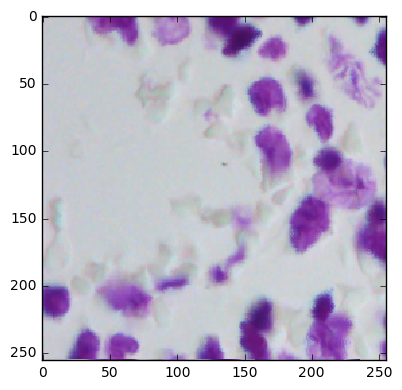

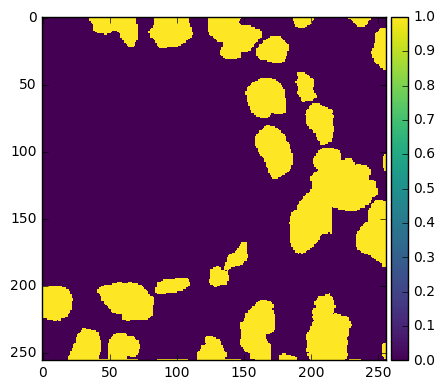

In [42]:
#SHOW
imshow(np.squeeze(X_trainn[800]))
plt.show()
imshow(np.squeeze(Y_trainn[800]))
plt.show()


In [43]:
#FOR X_trainn
from keras.layers import BatchNormalization
Build U-Net model
input2 = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
s = Lambda(lambda x: x / 255) (input2)

c1 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (s)
c1 = BatchNormalization() (c1)
c1 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c1)
p1 = MaxPooling2D((2, 2)) (c1)

c2 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p1)
c2 = BatchNormalization() (c2)
c2 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c2)
p2 = MaxPooling2D((2, 2)) (c2)

c3 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p2)
c3 = BatchNormalization() (c3)
c3 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c3)
p3 = MaxPooling2D((2, 2)) (c3)

c4 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p3)
c4 = BatchNormalization() (c4)
c4 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c4)
p4 = MaxPooling2D(pool_size=(2, 2)) (c4)

c5 = Conv2D(256, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p4)
c5 = BatchNormalization() (c5)
c5 = Conv2D(256, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c5)

u6 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same') (c5)
u6 = concatenate([u6, c4])
c6 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u6)
c6 = BatchNormalization() (c6)
c6 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c6)

u7 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same') (c6)
u7 = concatenate([u7, c3])
c7 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u7)
c7 = BatchNormalization() (c7)
c7 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c7)

u8 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same') (c7)
u8 = concatenate([u8, c2])
c8 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u8)
c8 = BatchNormalization() (c8)
c8 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c8)

u9 = Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same') (c8)
u9 = concatenate([u9, c1], axis=3)
c9 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u9)
c9 = BatchNormalization() (c9)
c9 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c9)

output2 = Conv2D(1, (1, 1), activation='sigmoid') (c9)

model = Model(inputs=[input2], outputs=[output2])
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=[bce_dice,dice_coef,mean_iou])
model.summary()
model = load_model('model-dsbowl2018-2.h5', custom_objects={'mean_iou': mean_iou,'bce_dice':bce_dice,'dice_coef':dice_coef})

In [44]:
earlystopper = EarlyStopping(patience=5, verbose=1)
checkpointer = ModelCheckpoint('model-dsbowl2018-5.h5', verbose=1, save_best_only=True)
history = model.fit(X_trainn, Y_trainn, validation_split=0.1, batch_size=16, epochs=50, 
                    callbacks=[earlystopper,checkpointer])

Train on 806 samples, validate on 90 samples
Epoch 1/50
806/806 [==============================] - 109s - loss: 0.0426 - bce_dice: 0.0982 - dice_coef: 0.9459 - mean_iou: 0.9191 - val_loss: 0.0727 - val_bce_dice: 0.1454 - val_dice_coef: 0.9299 - val_mean_iou: 0.9358
Epoch 2/50
806/806 [==============================] - 104s - loss: 0.0403 - bce_dice: 0.0935 - dice_coef: 0.9482 - mean_iou: 0.9362 - val_loss: 0.0696 - val_bce_dice: 0.1404 - val_dice_coef: 0.9317 - val_mean_iou: 0.9368
Epoch 3/50
806/806 [==============================] - 104s - loss: 0.0390 - bce_dice: 0.0904 - dice_coef: 0.9499 - mean_iou: 0.9371 - val_loss: 0.0725 - val_bce_dice: 0.1426 - val_dice_coef: 0.9324 - val_mean_iou: 0.9375
Epoch 4/50
806/806 [==============================] - 105s - loss: 0.0379 - bce_dice: 0.0879 - dice_coef: 0.9512 - mean_iou: 0.9378 - val_loss: 0.0720 - val_bce_dice: 0.1413 - val_dice_coef: 0.9331 - val_mean_iou: 0.9382
Epoch 5/50
806/806 [==============================] - 105s - loss: 0.03

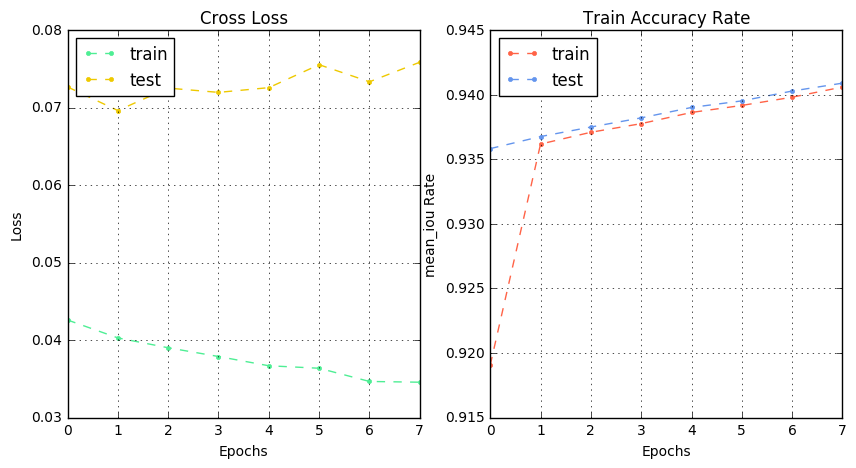

In [45]:
fig = plt.figure(figsize=(10,5))
plt.subplot(121)
plt.plot(history.history['loss'],'.--',color='#4EEE94')
plt.plot(history.history['val_loss'],'.--',color='#EEC900')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Cross Loss')
plt.legend(['train','test'], loc='upper left')
plt.grid(True)
# plt.show()
    # 准确率曲线marker='*'
plt.subplot(122)
plt.plot(history.history['mean_iou'],'.--',color='#FF6347')
plt.plot(history.history['val_mean_iou'],'.--',color='#6495ED')
plt.xlabel('Epochs')
plt.ylabel('mean_iou Rate')
plt.title('Train Accuracy Rate')
plt.legend(['train','test'], loc='upper left')
plt.grid(True)
plt.show()

D:\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and


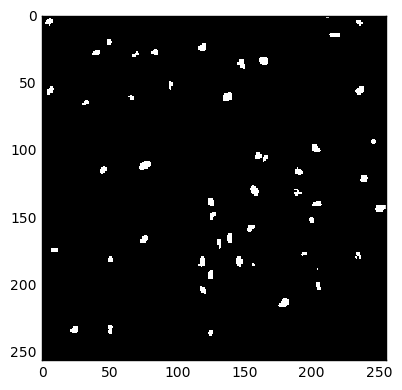

In [46]:
imshow(np.squeeze(Y_trainnn[11]))
plt.show()

In [42]:
import cv2

def get_more_images(imgs):
    
    more_images = []
    vert_flip_imgs = []
    hori_flip_imgs = []
    
    for i in range(0,imgs.shape[0]):
        a=imgs[i,:,:,0]
        b=imgs[i,:,:,1]
        c=imgs[i,:,:,2]
    
        av=cv2.flip(a,1)
        ah=cv2.flip(a,0)
        bv=cv2.flip(b,1)
        bh=cv2.flip(b,0)
        cv=cv2.flip(c,1)
        ch=cv2.flip(c,0)
    
        vert_flip_imgs.append(np.dstack((av, bv, cv)))
        hori_flip_imgs.append(np.dstack((ah, bh, ch)))
    
    v = np.array(vert_flip_imgs)
    h = np.array(hori_flip_imgs)
    
    more_images = np.concatenate((imgs,v,h))
    
    return more_images

def duplicate_labels(labels):
    more_images = []
    vert_flip_imgs = []
    hori_flip_imgs = []
    for i in range(0,labels.shape[0]):
        a=labels[i,:,:,0]
    
        av=cv2.flip(a,1)
        ah=cv2.flip(a,0)
        
        vert_flip_imgs.append(av.reshape(IMG_WIDTH,IMG_WIDTH,1))
        hori_flip_imgs.append(ah.reshape(IMG_WIDTH,IMG_WIDTH,1))
        
    v = np.array(vert_flip_imgs)
    h = np.array(hori_flip_imgs)
    duplicate_labels = np.concatenate((labels,v,h))
    return duplicate_labels
X_validationnn = X_trainnn[-10:,...]
Y_validationnn = Y_trainnn[-10:]
X_trainnn = X_trainnn[0:-10,...]
Y_trainnn = Y_trainnn[0:-10]
print("Validation Set of Size "+str(Y_validationnn.shape[0])+" Separated")
Y_trainnn.dtype = np.uint8
X_trainnn = get_more_images(X_trainnn)
Y_trainnn = duplicate_labels(Y_trainnn)
print (X_trainnn.shape)
print (Y_trainnn.shape)
print (X_validationnn.shape)
print (Y_validationnn.shape)
print("Data Rotation and Flipping Complete")
print (X_trainnn.shape)
print (Y_trainnn.shape)
print (X_validationnn.shape)
print (Y_validationnn.shape)
X_trainnn = np.concatenate((X_trainnn,X_validationnn),axis=0)
Y_trainnn = np.concatenate((Y_trainnn,Y_validationnn),axis=0)

Validation Set of Size 10 Separated
(18, 256, 256, 3)
(18, 256, 256, 1)
(10, 256, 256, 3)
(10, 256, 256, 1)
Data Rotation and Flipping Complete
(18, 256, 256, 3)
(18, 256, 256, 1)
(10, 256, 256, 3)
(10, 256, 256, 1)


D:\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and


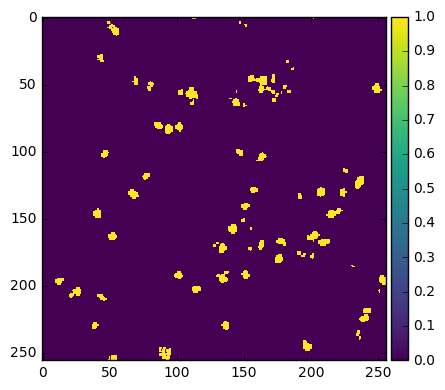

[[[228 228 228]
  [230 230 230]
  [230 230 230]
  ...
  [229 229 229]
  [228 228 228]
  [226 226 226]]

 [[233 233 233]
  [229 229 229]
  [229 229 229]
  ...
  [226 226 226]
  [227 227 227]
  [230 230 230]]

 [[228 228 228]
  [231 231 231]
  [227 227 227]
  ...
  [229 229 229]
  [228 228 228]
  [228 228 228]]

 ...

 [[233 233 233]
  [233 233 233]
  [230 230 230]
  ...
  [229 229 229]
  [227 227 227]
  [228 228 228]]

 [[233 233 233]
  [234 234 234]
  [230 230 230]
  ...
  [229 229 229]
  [229 229 229]
  [228 228 228]]

 [[233 233 233]
  [232 232 232]
  [231 231 231]
  ...
  [231 231 231]
  [228 228 228]
  [231 231 231]]]
[[[0]
  [0]
  [0]
  ...
  [0]
  [0]
  [0]]

 [[0]
  [0]
  [0]
  ...
  [0]
  [0]
  [0]]

 [[0]
  [0]
  [0]
  ...
  [0]
  [0]
  [0]]

 ...

 [[0]
  [0]
  [0]
  ...
  [0]
  [0]
  [0]]

 [[0]
  [0]
  [0]
  ...
  [0]
  [0]
  [0]]

 [[0]
  [0]
  [0]
  ...
  [0]
  [0]
  [0]]]


In [48]:
imshow(np.squeeze(Y_trainnn[18]))
plt.show()
print(format(X_trainnn[18]))
print(format(Y_trainnn[18]))

In [43]:
import os
import numpy as np
import matplotlib.pyplot as plt
from img_utils import (mls_affine_deformation_inv, 
                       mls_rigid_deformation_inv, 
                       mls_similarity_deformation_inv)

def generate_ctrl_pts(height, width, size=5, range=5):

    x, y = np.meshgrid(np.linspace(0, height, size), np.linspace(0, width, size))
    p = np.concatenate((x.reshape(size**2, 1), y.reshape(size**2, 1)), axis=1)
    noise = np.random.uniform(-range, range, (size, size, 2))
    noise[[0,-1], :, :] = 0
    noise[:, [0,-1], :] = 0
    q = p + noise.reshape(size**2, 2)
    return p, q

a = []
b = []

from skimage import io
for j in range(28): 
    train_images = X_trainnn[j]
    label_images = Y_trainnn[j]
    print(train_images.shape)
    print(label_images.shape)
    height = 256
    width = 256
    for i in range(50):
        p, q = generate_ctrl_pts(height, width, size=10, range=20)
        rigid = mls_rigid_deformation_inv(train_images, p, q)
        rigid1 = mls_rigid_deformation_inv(label_images, p, q)
        rigid = rigid*255
        rigid = rigid.astype(np.uint8)
        rigid1 = rigid1.astype(np.bool)
        print(X_trainnn.shape)
        print(Y_trainnn.shape)
        a.append(rigid)
        b.append(rigid1)
#         imshow(np.squeeze(b[0]))
#         plt.show()

a=np.array(a)
b=np.array(b)
print(a.shape)
print(b.shape)
X_trainnn = np.concatenate((X_trainnn,a),axis =0) 
Y_trainnn = np.concatenate((Y_trainnn,b),axis =0) 
print(X_trainnn.shape)
print(Y_trainnn.shape)

(256, 256, 3)
(256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)
(28, 256, 256, 3)
(28, 256, 256, 1)


D:\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and


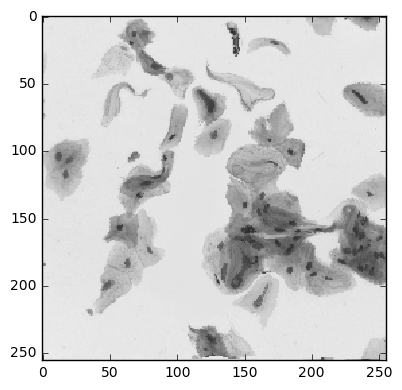

[[[231 231 231]
  [231 231 231]
  [231 231 231]
  ...
  [235 235 235]
  [232 232 232]
  [232 232 232]]

 [[231 231 231]
  [231 231 231]
  [230 230 230]
  ...
  [227 227 227]
  [234 234 234]
  [233 233 233]]

 [[230 230 230]
  [231 231 231]
  [230 230 230]
  ...
  [235 235 235]
  [232 232 232]
  [234 234 234]]

 ...

 [[234 234 234]
  [234 234 234]
  [234 234 234]
  ...
  [196 196 196]
  [193 193 193]
  [190 190 190]]

 [[234 234 234]
  [234 234 234]
  [234 234 234]
  ...
  [195 195 195]
  [196 196 196]
  [195 195 195]]

 [[231 231 231]
  [231 231 231]
  [231 231 231]
  ...
  [235 235 235]
  [232 232 232]
  [232 232 232]]]


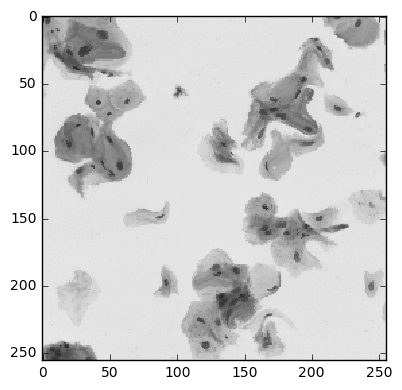

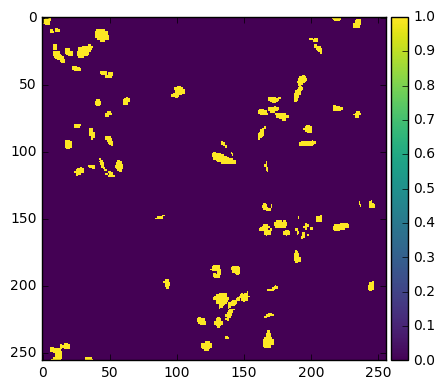

(1428, 256, 256, 3)
(1428, 256, 256, 1)
[[[ 92  92  92]
  [ 89  89  89]
  [ 76  76  76]
  ...
  [226 226 226]
  [227 227 227]
  [ 93  93  93]]

 [[ 96  96  96]
  [102 102 102]
  [ 73  73  73]
  ...
  [228 228 228]
  [227 227 227]
  [ 96  96  96]]

 [[121 121 121]
  [103 103 103]
  [ 67  67  67]
  ...
  [228 228 228]
  [228 228 228]
  [122 122 122]]

 ...

 [[149 149 149]
  [113 113 113]
  [ 98  98  98]
  ...
  [228 228 228]
  [228 228 228]
  [150 150 150]]

 [[146 146 146]
  [127 127 127]
  [ 95  95  95]
  ...
  [228 228 228]
  [228 228 228]
  [147 147 147]]

 [[150 150 150]
  [138 138 138]
  [110 110 110]
  ...
  [228 228 228]
  [228 228 228]
  [151 151 151]]]
[[[0]
  [1]
  [1]
  ...
  [0]
  [0]
  [0]]

 [[1]
  [1]
  [1]
  ...
  [0]
  [0]
  [0]]

 [[1]
  [1]
  [1]
  ...
  [0]
  [0]
  [0]]

 ...

 [[0]
  [0]
  [0]
  ...
  [0]
  [0]
  [0]]

 [[0]
  [0]
  [0]
  ...
  [0]
  [0]
  [0]]

 [[0]
  [0]
  [0]
  ...
  [0]
  [0]
  [0]]]


In [72]:
Y_trainnn =  np.array(Y_trainnn, np.bool)
X_trainnn =  np.array(X_trainnn, dtype=np.uint8)
imshow(rigid)
plt.show()
print(format(rigid))
plt.show()
imshow(X_trainnn[28])
plt.show()
imshow(np.squeeze(Y_trainnn[28]))
plt.show()
print (X_trainnn.shape)
print (Y_trainnn.shape)
print(format(X_trainnn[29]))
print(format(Y_trainnn[29]))

D:\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and


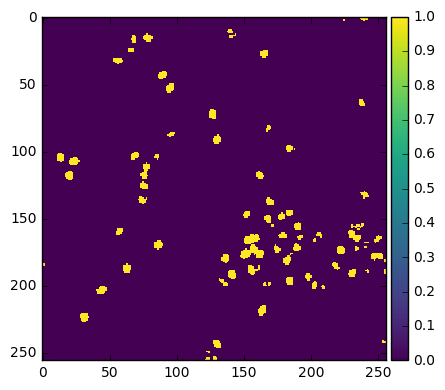

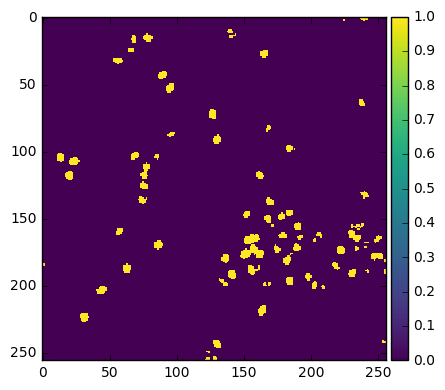

(256, 256, 3)
[[[0]
  [0]
  [1]
  ...
  [0]
  [0]
  [0]]

 [[0]
  [1]
  [1]
  ...
  [0]
  [0]
  [0]]

 [[0]
  [1]
  [1]
  ...
  [0]
  [0]
  [0]]

 ...

 [[0]
  [0]
  [0]
  ...
  [0]
  [0]
  [0]]

 [[0]
  [0]
  [0]
  ...
  [0]
  [0]
  [0]]

 [[0]
  [0]
  [0]
  ...
  [0]
  [0]
  [0]]]


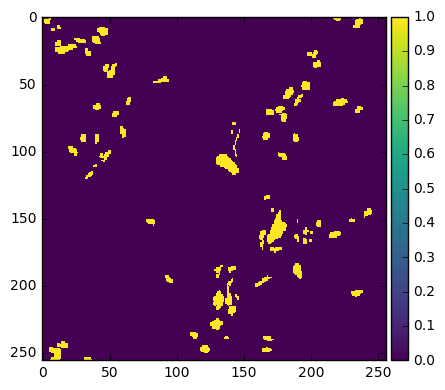

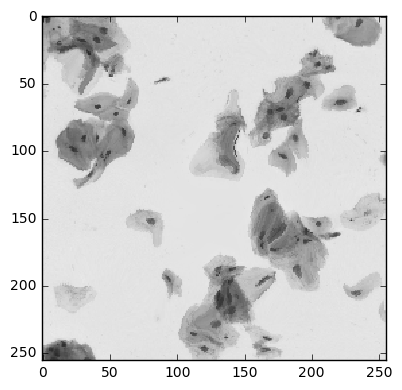

In [51]:
imshow(np.squeeze(Y_trainnn[27]))
plt.show()
imshow(np.squeeze(label_images))
plt.show()
print(X_trainnn[29].shape)
print(Y_trainnn[28])
imshow(np.squeeze(Y_trainnn[28]))
plt.show()
imshow(X_trainnn[28])
plt.show()


In [65]:
X_trainnnn = np.concatenate((X_train,X_trainn,X_trainnn),axis =0) 
Y_trainnnn = np.concatenate((Y_train,Y_trainn,Y_trainnn),axis =0) 
print(X_trainnnn.shape)
print(Y_trainnnn.shape)

(4531, 256, 256, 3)
(4531, 256, 256, 1)


In [35]:
X_trainnnnn = np.concatenate((X_train,X_trainn),axis =0) 
Y_trainnnnn = np.concatenate((Y_train,Y_trainn),axis =0) 
print(X_trainnnnn.shape)
print(Y_trainnnnn.shape)

(3103, 256, 256, 3)
(3103, 256, 256, 1)


In [68]:
num_example = X_trainnnn.shape[0]
arr = np.arange(num_example)
np.random.shuffle(arr)
X_trainnnn = X_trainnnn[arr]
Y_trainnnn = Y_trainnnn[arr]


In [70]:
print(X_trainnnn.shape)
print(Y_trainnnn.shape)

(4531, 256, 256, 3)
(4531, 256, 256, 1)


In [47]:
num_example = X_trainnn.shape[0]
arr = np.arange(num_example)
np.random.shuffle(arr)
X_trainnn = X_trainnn[arr]
Y_trainnn = Y_trainnn[arr]

In [48]:
print(X_trainnn.shape)
print(Y_trainnn.shape)

(1428, 256, 256, 3)
(1428, 256, 256, 1)


In [60]:
from keras.layers import BatchNormalization
Build U-Net model
input1 = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
s = Lambda(lambda x: x / 255) (input1)

c1 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (s)
c1 = BatchNormalization() (c1)
c1 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c1)
p1 = MaxPooling2D((2, 2)) (c1)

c2 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p1)
c2 = BatchNormalization() (c2)
c2 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c2)
p2 = MaxPooling2D((2, 2)) (c2)

c3 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p2)
c3 = BatchNormalization() (c3)
c3 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c3)
p3 = MaxPooling2D((2, 2)) (c3)

c4 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p3)
c4 = BatchNormalization() (c4)
c4 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c4)
p4 = MaxPooling2D(pool_size=(2, 2)) (c4)

c5 = Conv2D(256, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p4)
c5 = BatchNormalization() (c5)
c5 = Conv2D(256, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c5)

u6 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same') (c5)
u6 = concatenate([u6, c4])
c6 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u6)
c6 = BatchNormalization() (c6)
c6 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c6)

u7 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same') (c6)
u7 = concatenate([u7, c3])
c7 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u7)
c7 = BatchNormalization() (c7)
c7 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c7)

u8 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same') (c7)
u8 = concatenate([u8, c2])
c8 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u8)
c8 = BatchNormalization() (c8)
c8 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c8)

u9 = Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same') (c8)
u9 = concatenate([u9, c1], axis=3)
c9 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u9)
c9 = BatchNormalization() (c9)
c9 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c9)

output1 = Conv2D(1, (1, 1), activation='sigmoid') (c9)

model = Model(inputs=[input1], outputs=[output1])
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=[bce_dice,dice_coef,mean_iou])
model.summary()
model = load_model('model-dsbowl2018-23.h5', custom_objects={'bce_dice':bce_dice,'mean_iou': mean_iou,'dice_coef':dice_coef})

Tensor("metrics_5/bce_dice/Reshape:0", shape=(?,), dtype=float32)
Tensor("metrics_5/bce_dice/Reshape_1:0", shape=(?,), dtype=float32)
Tensor("metrics_5/bce_dice/Reshape_2:0", shape=(?,), dtype=float32)
Tensor("metrics_5/bce_dice/Reshape_3:0", shape=(?,), dtype=float32)
Tensor("metrics_5/dice_coef/Reshape:0", shape=(?,), dtype=float32)
Tensor("metrics_5/dice_coef/Reshape_1:0", shape=(?,), dtype=float32)


In [61]:
earlystopper = EarlyStopping(patience=5, verbose=1)
checkpointer = ModelCheckpoint('model-dsbowl2018-24.h5', verbose=1, save_best_only=True)
history = model.fit(X_trainnn, Y_trainnn, validation_split=0.1, batch_size=32, epochs=50,
                    callbacks=[earlystopper,checkpointer])

Train on 1285 samples, validate on 143 samples
Epoch 1/50
1285/1285 [==============================] - 177s - loss: 0.0077 - bce_dice: 0.0974 - dice_coef: 0.9142 - mean_iou: 0.9049 - val_loss: 0.0157 - val_bce_dice: 0.1502 - val_dice_coef: 0.8741 - val_mean_iou: 0.9263
Epoch 2/50
1285/1285 [==============================] - 168s - loss: 0.0077 - bce_dice: 0.0972 - dice_coef: 0.9144 - mean_iou: 0.9251 - val_loss: 0.0154 - val_bce_dice: 0.1441 - val_dice_coef: 0.8793 - val_mean_iou: 0.9253
Epoch 3/50
1285/1285 [==============================] - 168s - loss: 0.0072 - bce_dice: 0.0915 - dice_coef: 0.9192 - mean_iou: 0.9256 - val_loss: 0.0157 - val_bce_dice: 0.1433 - val_dice_coef: 0.8803 - val_mean_iou: 0.9261
Epoch 4/50
1285/1285 [==============================] - 168s - loss: 0.0071 - bce_dice: 0.0892 - dice_coef: 0.9212 - mean_iou: 0.9263 - val_loss: 0.0166 - val_bce_dice: 0.1490 - val_dice_coef: 0.8760 - val_mean_iou: 0.9269
Epoch 5/50
1285/1285 [==============================] - 168s 

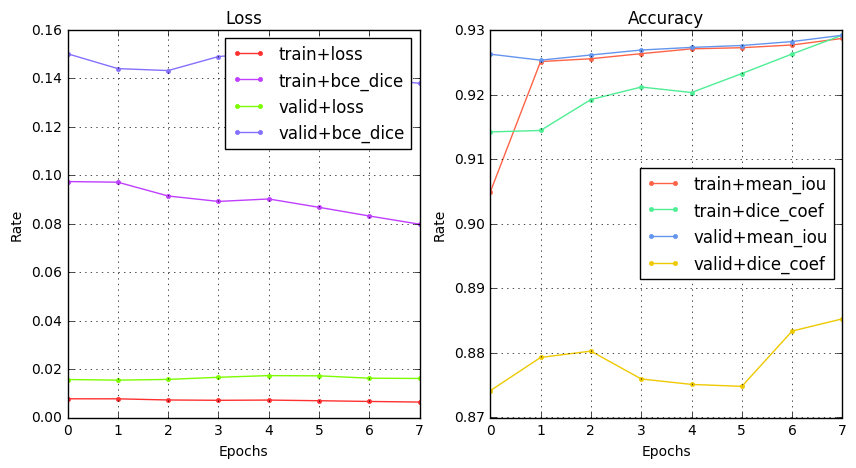

In [62]:
fig = plt.figure(figsize=(10,5))
plt.subplot(121)
plt.plot(history.history['loss'],'.-',color='#FF3030')
plt.plot(history.history['bce_dice'],'.-',color='#BF3EFF')
plt.plot(history.history['val_loss'],'.-',color='#7CFC00')
plt.plot(history.history['val_bce_dice'],'.-',color='#8470FF')
plt.xlabel('Epochs')
plt.ylabel('Rate')
plt.title('Loss')
plt.legend(['train+loss','train+bce_dice','valid+loss','valid+bce_dice'], loc='best')
plt.grid(True)
# plt.show()
    # 准确率曲线marker='*'
plt.subplot(122)
plt.plot(history.history['mean_iou'],'.-',color='#FF6347')
plt.plot(history.history['dice_coef'],'.-',color='#4EEE94')
plt.plot(history.history['val_mean_iou'],'.-',color='#6495ED')
plt.plot(history.history['val_dice_coef'],'.-',color='#EEC900')
plt.xlabel('Epochs')
plt.ylabel('Rate')
plt.title('Accuracy')
plt.legend(['train+mean_iou','train+dice_coef','valid+mean_iou','valid+dice_coef'], loc='best')
plt.grid(True)
plt.show()

In [47]:
from keras.layers import BatchNormalization
Build U-Net model
input2 = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
s = Lambda(lambda x: x / 255) (input2)

c1 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (s)
c1 = BatchNormalization() (c1)
c1 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c1)
p1 = MaxPooling2D((2, 2)) (c1)

c2 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p1)
c2 = BatchNormalization() (c2)
c2 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c2)
p2 = MaxPooling2D((2, 2)) (c2)

c3 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p2)
c3 = BatchNormalization() (c3)
c3 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c3)
p3 = MaxPooling2D((2, 2)) (c3)

c4 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p3)
c4 = BatchNormalization() (c4)
c4 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c4)
p4 = MaxPooling2D(pool_size=(2, 2)) (c4)

c5 = Conv2D(256, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p4)
c5 = BatchNormalization() (c5)
c5 = Conv2D(256, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c5)

u6 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same') (c5)
u6 = concatenate([u6, c4])
c6 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u6)
c6 = BatchNormalization() (c6)
c6 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c6)

u7 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same') (c6)
u7 = concatenate([u7, c3])
c7 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u7)
c7 = BatchNormalization() (c7)
c7 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c7)

u8 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same') (c7)
u8 = concatenate([u8, c2])
c8 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u8)
c8 = BatchNormalization() (c8)
c8 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c8)

u9 = Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same') (c8)
u9 = concatenate([u9, c1], axis=3)
c9 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u9)
c9 = BatchNormalization() (c9)
c9 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c9)

output2 = Conv2D(1, (1, 1), activation='sigmoid') (c9)

model = Model(inputs=[input2], outputs=[output2])
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=[bce_dice,dice_coef,mean_iou])
model.summary()
model = load_model('model-dsbowl2018-14.h5', custom_objects={'bce_dice':bce_dice,'mean_iou': mean_iou,'dice_coef':dice_coef})

In [48]:
earlystopper = EarlyStopping(patience=5, verbose=1)
checkpointer = ModelCheckpoint('model-dsbowl2018-17.h5', verbose=1, save_best_only=True)
history = model.fit(X_trainn, Y_trainn, validation_split=0.1, batch_size=32, epochs=50,
                    callbacks=[earlystopper,checkpointer])

Train on 1411 samples, validate on 157 samples
Epoch 1/50
1411/1411 [==============================] - 217s - loss: 0.0567 - bce_dice: 0.1316 - dice_coef: 0.9279 - mean_iou: 0.8941 - val_loss: 0.1015 - val_bce_dice: 0.2073 - val_dice_coef: 0.8997 - val_mean_iou: 0.9150
Epoch 2/50
1411/1411 [==============================] - 185s - loss: 0.0544 - bce_dice: 0.1255 - dice_coef: 0.9314 - mean_iou: 0.9140 - val_loss: 0.0984 - val_bce_dice: 0.1986 - val_dice_coef: 0.9048 - val_mean_iou: 0.9152
Epoch 3/50
1411/1411 [==============================] - 185s - loss: 0.0516 - bce_dice: 0.1192 - dice_coef: 0.9346 - mean_iou: 0.9158 - val_loss: 0.1157 - val_bce_dice: 0.2258 - val_dice_coef: 0.8959 - val_mean_iou: 0.9169
Epoch 4/50
1411/1411 [==============================] - 185s - loss: 0.0813 - bce_dice: 0.1878 - dice_coef: 0.8991 - mean_iou: 0.9117 - val_loss: 0.1289 - val_bce_dice: 0.2565 - val_dice_coef: 0.8803 - val_mean_iou: 0.9085
Epoch 5/50
1411/1411 [==============================] - 185s 

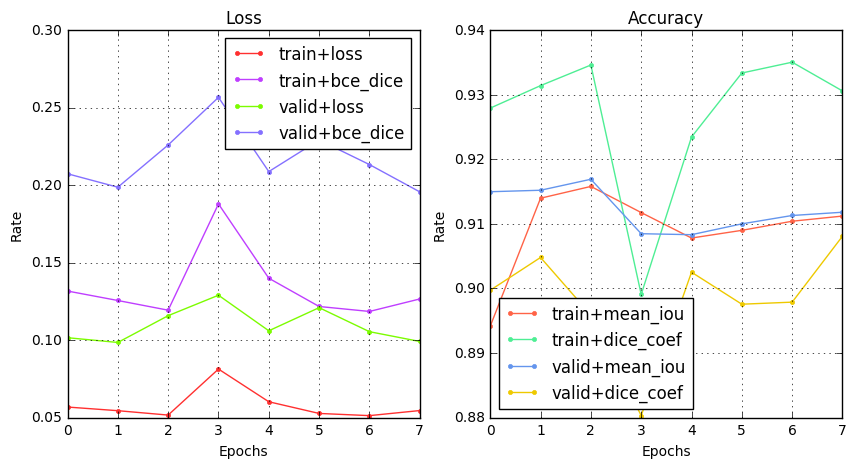

In [49]:
fig = plt.figure(figsize=(10,5))
plt.subplot(121)
plt.plot(history.history['loss'],'.-',color='#FF3030')
plt.plot(history.history['bce_dice'],'.-',color='#BF3EFF')
plt.plot(history.history['val_loss'],'.-',color='#7CFC00')
plt.plot(history.history['val_bce_dice'],'.-',color='#8470FF')
plt.xlabel('Epochs')
plt.ylabel('Rate')
plt.title('Loss')
plt.legend(['train+loss','train+bce_dice','valid+loss','valid+bce_dice'], loc='best')
plt.grid(True)
# plt.show()
    # 准确率曲线marker='*'
plt.subplot(122)
plt.plot(history.history['mean_iou'],'.-',color='#FF6347')
plt.plot(history.history['dice_coef'],'.-',color='#4EEE94')
plt.plot(history.history['val_mean_iou'],'.-',color='#6495ED')
plt.plot(history.history['val_dice_coef'],'.-',color='#EEC900')
plt.xlabel('Epochs')
plt.ylabel('Rate')
plt.title('Accuracy')
plt.legend(['train+mean_iou','train+dice_coef','valid+mean_iou','valid+dice_coef'], loc='best')
plt.grid(True)
plt.show()

In [63]:
from keras.layers import BatchNormalization
Build U-Net model
input3 = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
s = Lambda(lambda x: x / 255) (input3)

c1 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (s)
c1 = BatchNormalization() (c1)
c1 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c1)
p1 = MaxPooling2D((2, 2)) (c1)

c2 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p1)
c2 = BatchNormalization() (c2)
c2 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c2)
p2 = MaxPooling2D((2, 2)) (c2)

c3 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p2)
c3 = BatchNormalization() (c3)
c3 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c3)
p3 = MaxPooling2D((2, 2)) (c3)

c4 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p3)
c4 = BatchNormalization() (c4)
c4 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c4)
p4 = MaxPooling2D(pool_size=(2, 2)) (c4)

c5 = Conv2D(256, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p4)
c5 = BatchNormalization() (c5)
c5 = Conv2D(256, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c5)

u6 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same') (c5)
u6 = concatenate([u6, c4])
c6 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u6)
c6 = BatchNormalization() (c6)
c6 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c6)

u7 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same') (c6)
u7 = concatenate([u7, c3])
c7 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u7)
c7 = BatchNormalization() (c7)
c7 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c7)

u8 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same') (c7)
u8 = concatenate([u8, c2])
c8 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u8)
c8 = BatchNormalization() (c8)
c8 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c8)

u9 = Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same') (c8)
u9 = concatenate([u9, c1], axis=3)
c9 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u9)
c9 = BatchNormalization() (c9)
c9 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c9)

output3 = Conv2D(1, (1, 1), activation='sigmoid') (c9)

model = Model(inputs=[input3], outputs=[output3])
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=[bce_dice,dice_coef,mean_iou])
model.summary()
model = load_model('model-dsbowl2018-15.h5', custom_objects={'bce_dice':bce_dice,'mean_iou': mean_iou,'dice_coef':dice_coef})

In [64]:
earlystopper = EarlyStopping(patience=5, verbose=1)
checkpointer = ModelCheckpoint('model-dsbowl2018-18.h5', verbose=1, save_best_only=True)
history = model.fit(X_trainnn, Y_trainnn, validation_split=0.1, batch_size=32, epochs=50,shuffle=True,
                    callbacks=[earlystopper,checkpointer])

Train on 1285 samples, validate on 143 samples
Epoch 1/50
1285/1285 [==============================] - 178s - loss: 0.0283 - bce_dice: 0.4049 - dice_coef: 0.6864 - mean_iou: 0.7315 - val_loss: 0.2418 - val_bce_dice: 5.7275 - val_dice_coef: 0.0042 - val_mean_iou: 0.7458
Epoch 2/50
1285/1285 [==============================] - 169s - loss: 0.0245 - bce_dice: 0.3429 - dice_coef: 0.7275 - mean_iou: 0.7427 - val_loss: 0.2314 - val_bce_dice: 5.7065 - val_dice_coef: 0.0043 - val_mean_iou: 0.7488
Epoch 3/50
1285/1285 [==============================] - 169s - loss: 0.0213 - bce_dice: 0.2937 - dice_coef: 0.7617 - mean_iou: 0.7509 - val_loss: 0.2392 - val_bce_dice: 5.6413 - val_dice_coef: 0.0046 - val_mean_iou: 0.7570
Epoch 4/50
1285/1285 [==============================] - 169s - loss: 0.0194 - bce_dice: 0.2631 - dice_coef: 0.7838 - mean_iou: 0.7596 - val_loss: 0.2198 - val_bce_dice: 4.2286 - val_dice_coef: 0.0202 - val_mean_iou: 0.7646
Epoch 5/50
1285/1285 [==============================] - 169s 

In [129]:
# imshow(X_trainnn[27])
# plt.show()

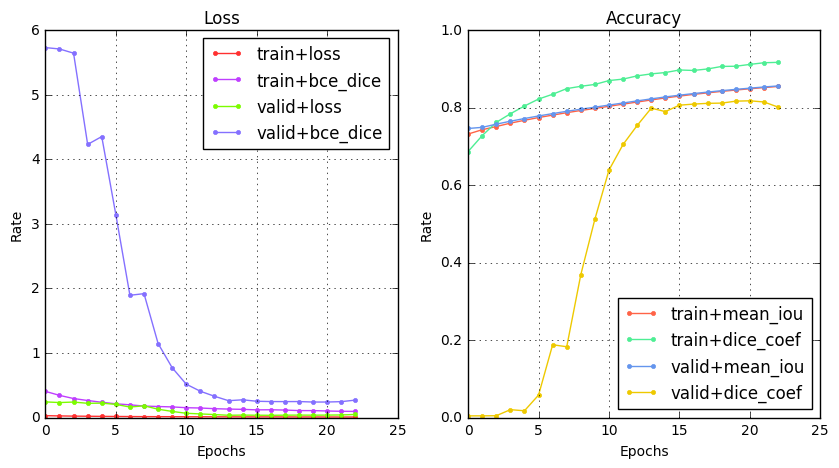

In [65]:
fig = plt.figure(figsize=(10,5))
plt.subplot(121)
plt.plot(history.history['loss'],'.-',color='#FF3030')
plt.plot(history.history['bce_dice'],'.-',color='#BF3EFF')
plt.plot(history.history['val_loss'],'.-',color='#7CFC00')
plt.plot(history.history['val_bce_dice'],'.-',color='#8470FF')
plt.xlabel('Epochs')
plt.ylabel('Rate')
plt.title('Loss')
plt.legend(['train+loss','train+bce_dice','valid+loss','valid+bce_dice'], loc='best')
plt.grid(True)
# plt.show()
    # 准确率曲线marker='*'
plt.subplot(122)
plt.plot(history.history['mean_iou'],'.-',color='#FF6347')
plt.plot(history.history['dice_coef'],'.-',color='#4EEE94')
plt.plot(history.history['val_mean_iou'],'.-',color='#6495ED')
plt.plot(history.history['val_dice_coef'],'.-',color='#EEC900')
plt.xlabel('Epochs')
plt.ylabel('Rate')
plt.title('Accuracy')
plt.legend(['train+mean_iou','train+dice_coef','valid+mean_iou','valid+dice_coef'], loc='best')
plt.grid(True)
plt.show()

In [59]:
# Predict on train, val and test
model = load_model('model-dsbowl2018-20.h5', custom_objects={'bce_dice':bce_dice,'mean_iou': mean_iou,'dice_coef':dice_coef})
preds_train = model.predict(X_train[:int(X_train.shape[0]*0.9)], verbose=1)
preds_val = model.predict(X_train[int(X_train.shape[0]*0.9):], verbose=1)
preds_test = model.predict(X_test, verbose=1)
# Threshold predictions
preds_train_t = (preds_train > 0.5).astype(np.uint8)
preds_val_t = (preds_val > 0.5).astype(np.uint8)
preds_test_t = (preds_test > 0.5).astype(np.uint8)

# Create list of upsampled test masks
preds_test_upsampled = []
for i in range(len(preds_test)):
    preds_test_upsampled.append(resize(np.squeeze(preds_test[i]), 
                                       (sizes_test[i][0], sizes_test[i][1]), 
                                       mode='constant', preserve_range=True))

64/65 [============================>.] - ETA: 0s

In [58]:
from keras import backend as K
from keras.metrics import binary_crossentropy
from sklearn import preprocessing
smooth = 1.

def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    print(y_true_f)
    y_pred_f = K.flatten(y_pred)
    print(y_pred_f)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)
def bce_dice(y_true, y_pred):
    y_true_b = K.flatten(y_true)
    print(y_true_b)
    y_pred_b = K.flatten(y_pred)
    print(y_pred_b)
    return binary_crossentropy(y_true_b, y_pred_b)-K.log(dice_coef(y_true, y_pred))

In [91]:
ture = Y_train[int(X_train.shape[0]*0.9):].astype(np.float32)
sc= dice_coef(ture,preds_val)
# init = tf.global_variables_initializer()
# sess.run(init)
print(K.get_session().run(sc))

Tensor("Reshape_42:0", shape=(10092544,), dtype=float32)
Tensor("Reshape_43:0", shape=(10092544,), dtype=float32)
0.8995176


In [2]:
ture1 = tf.convert_to_tensor(Y_train[int(X_train.shape[0]*0.9):].astype(np.float32))
pre = tf.convert_to_tensor(preds_val)
sb = bce_dice(ture1,pre)
print(K.get_session().run(sb))

NameError: name 'tf' is not defined

In [37]:
model = load_model('model-dsbowl2018-22.h5', custom_objects={'bce_dice':bce_dice,'mean_iou': mean_iou,'dice_coef':dice_coef})
preds_trainn = model.predict(X_trainn[:int(X_trainn.shape[0]*0.9)], verbose=1)
preds_valn = model.predict(X_trainn[int(X_trainn.shape[0]*0.9):], verbose=1)
# preds_testn = model.predict(X_test, verbose=1)
# Threshold predictions
# preds_train_t = (preds_train > 0.5).astype(np.uint8)
# preds_val_t = (preds_val > 0.5).astype(np.uint8)
# preds_test_t = (preds_test > 0.5).astype(np.uint8)

# Create list of upsampled test masks
# preds_test_upsampled = []
# for i in range(len(preds_test)):
#     preds_test_upsampled.append(resize(np.squeeze(preds_test[i]), 
#                                        (sizes_test[i][0], sizes_test[i][1]), 
#                                        mode='constant', preserve_range=True))

157/157 [==============================] - 1s     


In [38]:
ture = Y_trainn[int(X_trainn.shape[0]*0.9):].astype(np.float32)
sc= dice_coef(ture,preds_valn)
# init = tf.global_variables_initializer()
# sess.run(init)
print(K.get_session().run(sc))

0.95444894


In [41]:

ture1 = tf.convert_to_tensor(Y_trainn[int(X_trainn.shape[0]*0.9):].astype(np.float32))
pre = tf.convert_to_tensor(preds_valn)
sb = bce_dice(ture1,pre)
print(K.get_session().run(sb))

Tensor("Reshape_4:0", shape=(10289152,), dtype=float32)
Tensor("Reshape_5:0", shape=(10289152,), dtype=float32)
Tensor("Reshape_6:0", shape=(10289152,), dtype=float32)
Tensor("Reshape_7:0", shape=(10289152,), dtype=float32)
0.08549741


In [65]:
model = load_model('model-dsbowl2018-24.h5', custom_objects={'bce_dice':bce_dice,'mean_iou': mean_iou,'dice_coef':dice_coef})
preds_trainnn = model.predict(X_trainnn[:int(X_trainnn.shape[0]*0.9)], verbose=1)
preds_valnn = model.predict(X_trainnn[int(X_trainnn.shape[0]*0.9):], verbose=1)

Tensor("metrics_7/bce_dice/Reshape:0", shape=(?,), dtype=float32)
Tensor("metrics_7/bce_dice/Reshape_1:0", shape=(?,), dtype=float32)
Tensor("metrics_7/bce_dice/Reshape_2:0", shape=(?,), dtype=float32)
Tensor("metrics_7/bce_dice/Reshape_3:0", shape=(?,), dtype=float32)
Tensor("metrics_7/dice_coef/Reshape:0", shape=(?,), dtype=float32)
Tensor("metrics_7/dice_coef/Reshape_1:0", shape=(?,), dtype=float32)
143/143 [==============================] - 1s     


In [66]:
ture = Y_trainnn[int(X_trainnn.shape[0]*0.9):].astype(np.float32)
sc= dice_coef(ture,preds_valnn)
# init = tf.global_variables_initializer()
# sess.run(init)
print(K.get_session().run(sc))

Tensor("Reshape_24:0", shape=(9371648,), dtype=float32)
Tensor("Reshape_25:0", shape=(9371648,), dtype=float32)
0.87992567


In [67]:
ture1 = tf.convert_to_tensor(Y_trainnn[int(X_trainnn.shape[0]*0.9):].astype(np.float32))
pre = tf.convert_to_tensor(preds_valnn)
sb = bce_dice(ture1,pre)
print(K.get_session().run(sb))

Tensor("Reshape_26:0", shape=(9371648,), dtype=float32)
Tensor("Reshape_27:0", shape=(9371648,), dtype=float32)
Tensor("Reshape_28:0", shape=(9371648,), dtype=float32)
Tensor("Reshape_29:0", shape=(9371648,), dtype=float32)
0.14325012


In [66]:
model = load_model('model-dsbowl2018-24.h5', custom_objects={'mean_iou': mean_iou,'bce_dice':bce_dice,'dice_coef':dice_coef})

In [67]:
preds_t = model.predict(X_t, verbose=1)

1/1 [==============================] - 1s


D:\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and


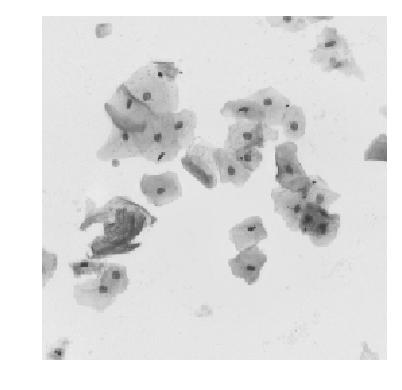

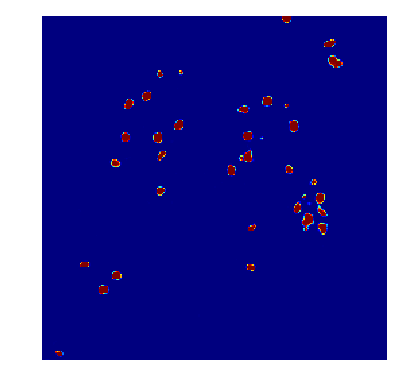

In [69]:
imshow(np.squeeze(X_t))
plt.axis('off')
plt.show()
imshow(np.squeeze(preds_t),cmap=plt.cm.jet)
plt.axis('off')
plt.show()

D:\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and


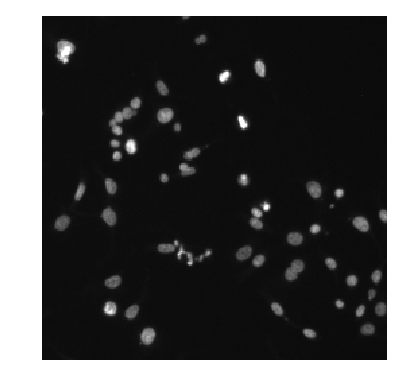

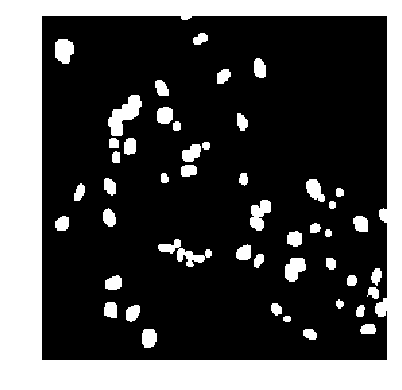

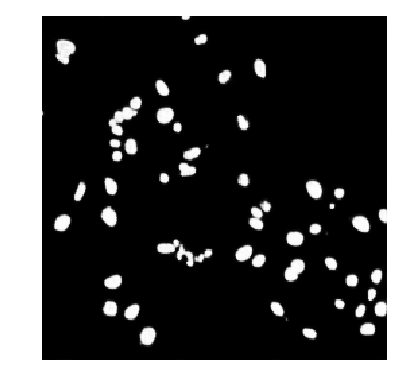

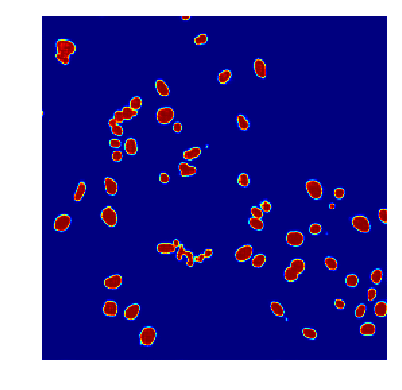

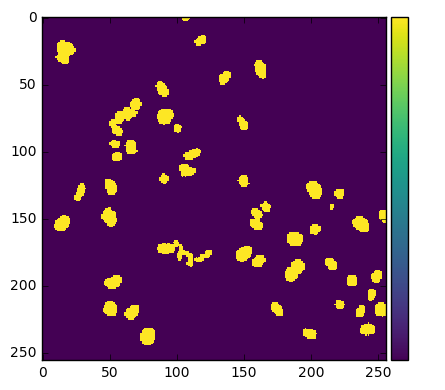

[[False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]
 ...
 [False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
0.9475950814324727


D:\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1113: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
D:\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1115: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


0.6408845636159819
0.9654205333202415
0.9940338134765625


In [128]:
imshow(X_train[:int(X_train.shape[0]*0.9)][21])
plt.axis('off')
plt.show()
imshow(np.squeeze(Y_train[:int(X_train.shape[0]*0.9)][21]))
plt.axis('off')
plt.show()
imshow(np.squeeze(preds_train[21]))
plt.axis('off')
plt.show()
imshow(np.squeeze(preds_train[21]),cmap=plt.cm.jet)
plt.axis('off')
plt.show()
imshow(np.squeeze(preds_train_t[21]))
plt.axis('off')
plt.show()
from sklearn.metrics import jaccard_similarity_score
from sklearn.metrics import f1_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_curve
from sklearn import metrics
a= Y_train[2].reshape(256,256)
b= preds_train_t[2].reshape(256,256)
print(a)
print(b)
print(jaccard_similarity_score(a,b))
print(f1_score(a, b, average='macro'))
a =a.flatten() 
b =b.flatten() 
fpr, tpr, thresholds = metrics.roc_curve(a, b)
print(metrics.auc(fpr, tpr))
print(accuracy_score(a, b))

D:\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and


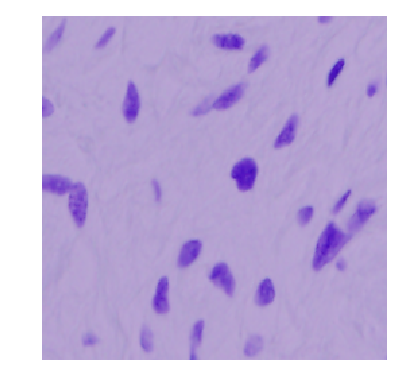

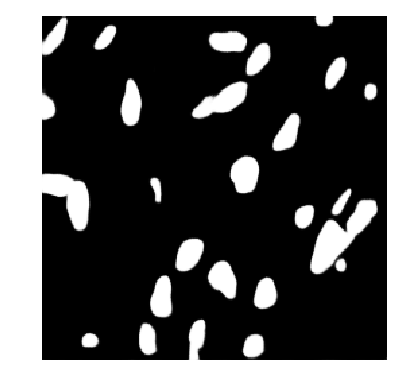

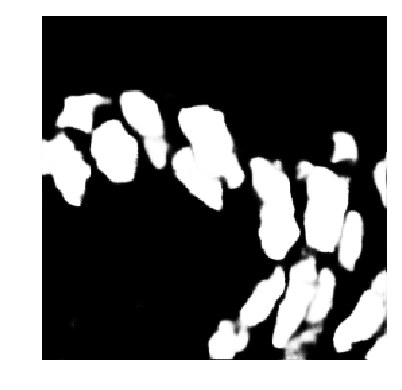

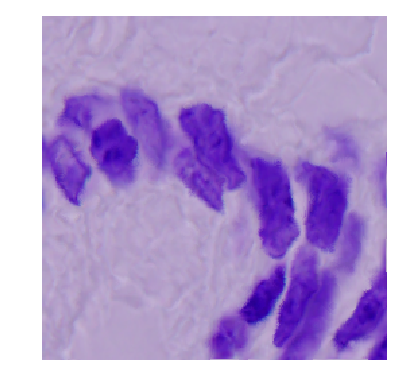

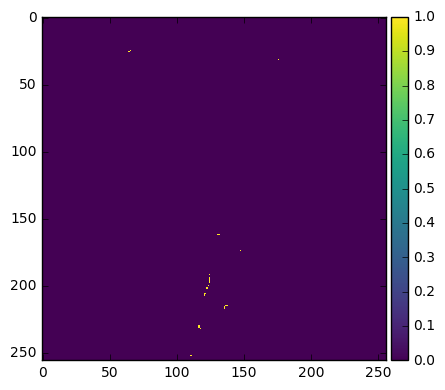

In [133]:
imshow(X_trainn[:int(X_trainn.shape[0]*0.9)][6])
plt.axis('off')
plt.show()
imshow(np.squeeze(preds_trainn[6]))
plt.axis('off')
plt.show()
imshow(np.squeeze(preds_valn[6]))
plt.axis('off')
plt.show()
imshow(X_trainn[int(X_trainn.shape[0]*0.9):][6])
plt.axis('off')
plt.show()
imshow(np.squeeze(preds_t))
plt.show()

D:\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and


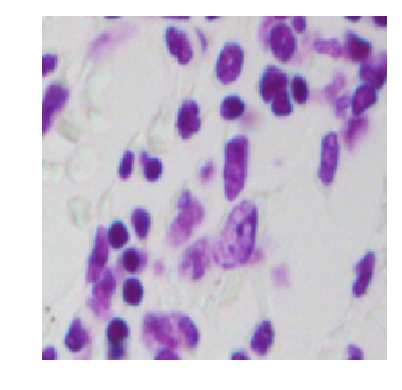

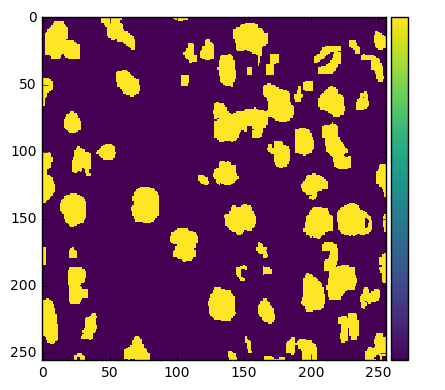

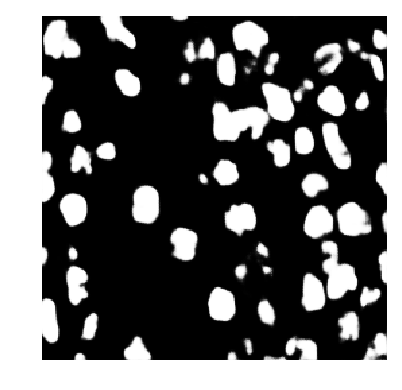

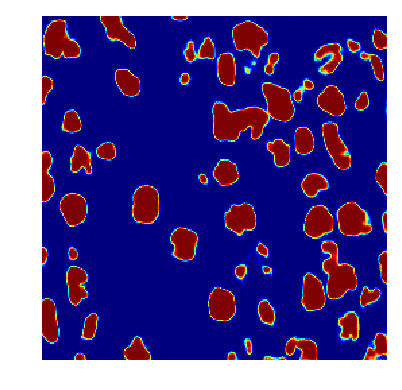

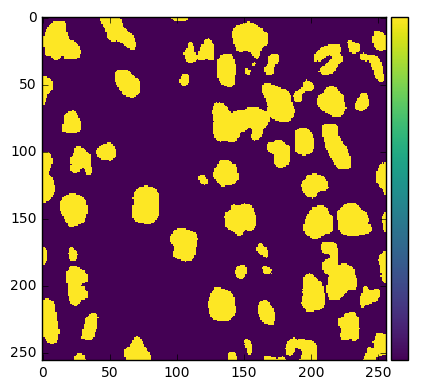

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
0.9600663739235811


D:\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1113: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
D:\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1115: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


0.6086755945428287
0.9962132048303411
0.995086669921875


In [146]:
imshow(X_trainn[:int(X_trainn.shape[0]*0.9)][21])
plt.axis('off')
plt.show()
imshow(np.squeeze(Y_trainn[:int(X_trainn.shape[0]*0.9)][1]))
plt.axis('off')
plt.show()
imshow(np.squeeze(preds_trainn[1]))
plt.axis('off')
plt.show()
imshow(np.squeeze(preds_trainn[1]),cmap=plt.cm.jet)
plt.axis('off')
plt.show()
imshow(np.squeeze(preds_train_tn[1]))
plt.axis('off')
plt.show()
from sklearn.metrics import jaccard_similarity_score
from sklearn.metrics import f1_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_curve
from sklearn import metrics
a= Y_trainn[2].reshape(256,256)
b= preds_train_tn[2].reshape(256,256)
print(a)
print(b)
print(jaccard_similarity_score(a,b))
print(f1_score(a, b, average='macro'))
a =a.flatten() 
b =b.flatten() 
fpr, tpr, thresholds = metrics.roc_curve(a, b)
print(metrics.auc(fpr, tpr))
print(accuracy_score(a, b))

D:\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and


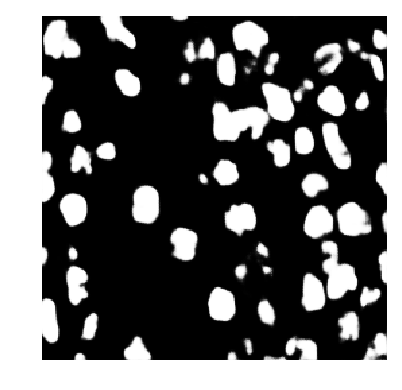

In [64]:
imshow(np.squeeze(preds_trainn[1]))
plt.axis('off')
plt.show()

D:\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and


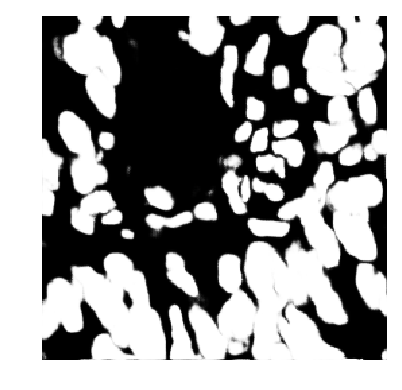

In [65]:
imshow(np.squeeze(preds_valn[2]))
plt.axis('off')
plt.show()

In [49]:
# # Predict on train, val and test
# model = load_model('model-dsbowl2018-6.h5', custom_objects={'mean_iou': mean_iou})
# preds_trainnn = model.predict(X_trainnn[:int(X_trainnn.shape[0]*0.9)], verbose=1)
# preds_valnn = model.predict(X_trainnn[int(X_trainnn.shape[0]*0.9):], verbose=1)
# # Threshold predictions
# preds_train_tnn = (preds_trainnn > 0.5).astype(np.uint8)
# preds_val_tnn = (preds_valnn > 0.5).astype(np.uint8)

NameError: name 'X_trainnn' is not defined

D:\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and


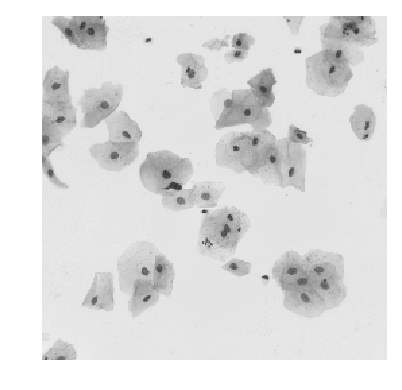

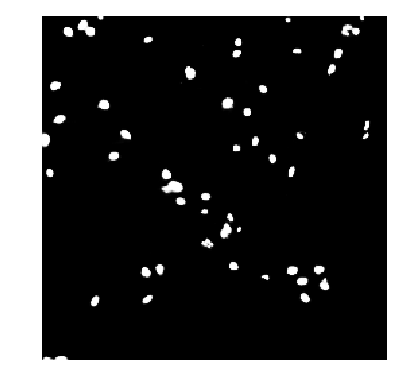

In [61]:
imshow(np.squeeze(X_t))
plt.axis('off')
plt.show()
imshow(np.squeeze(preds_t))
plt.axis('off')
plt.show()

D:\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and


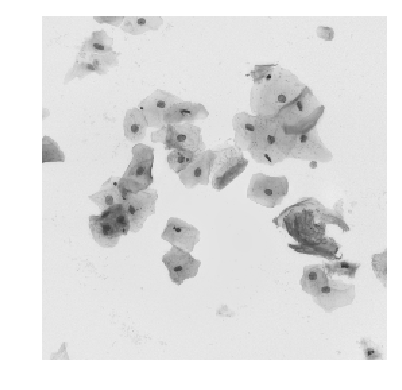

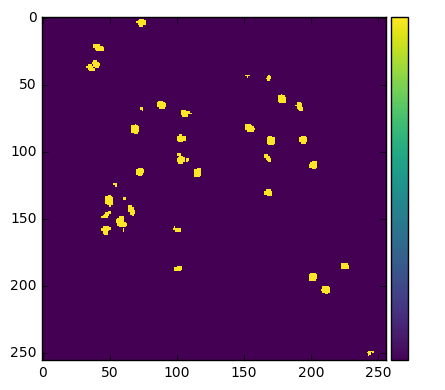

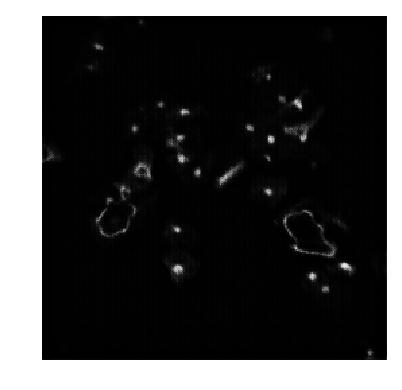

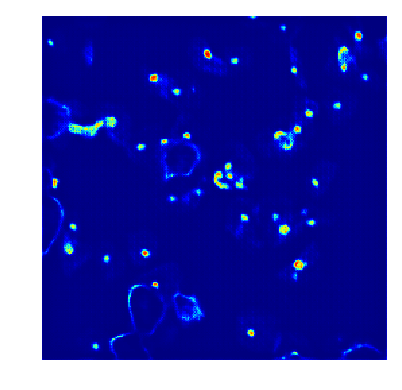

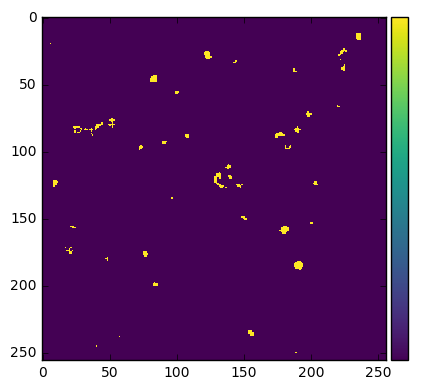

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
0.509073046722101


D:\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1113: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
D:\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1115: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


0.09459782744429483
0.585843092833744
0.987152099609375


In [141]:
imshow(X_trainnn[:int(X_trainnn.shape[0]*0.9)][7])
plt.axis('off')
plt.show()
imshow(np.squeeze(Y_trainnn[:int(X_trainnn.shape[0]*0.9)][7]))
plt.axis('off')
plt.show()
imshow(np.squeeze(preds_trainnn[7]))
plt.axis('off')
plt.show()
imshow(np.squeeze(preds_trainnn[3]),cmap=plt.cm.jet)
plt.axis('off')
plt.show()
imshow(np.squeeze(preds_train_tnn[3]))
plt.axis('off')
plt.show()
from sklearn.metrics import jaccard_similarity_score
from sklearn.metrics import f1_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_curve
from sklearn import metrics
a= Y_trainnn[1].reshape(256,256)
b= preds_train_tnn[1].reshape(256,256)
print(a)
print(b)
print(jaccard_similarity_score(a,b))
print(f1_score(a, b, average='macro'))
a =a.flatten() 
b =b.flatten()
fpr, tpr, thresholds = metrics.roc_curve(a, b)
print(metrics.auc(fpr, tpr))
print(accuracy_score(a, b))

D:\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and


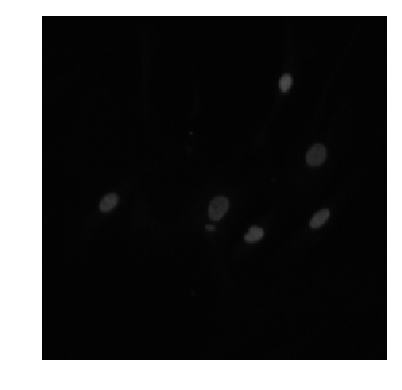

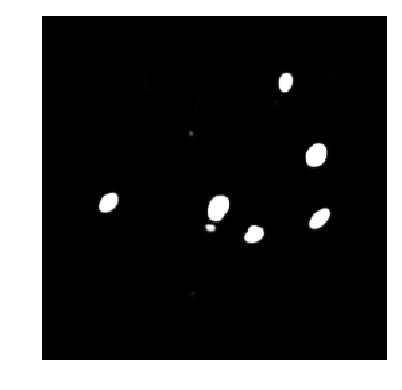

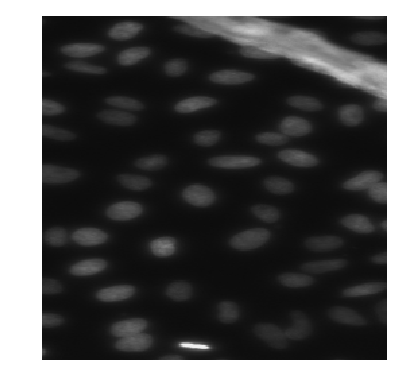

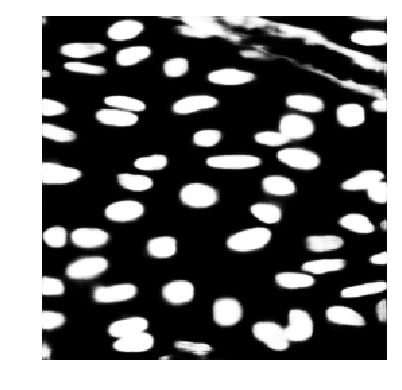

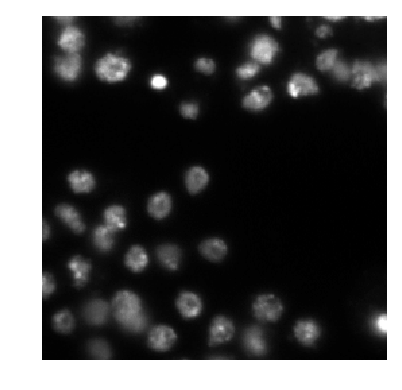

...

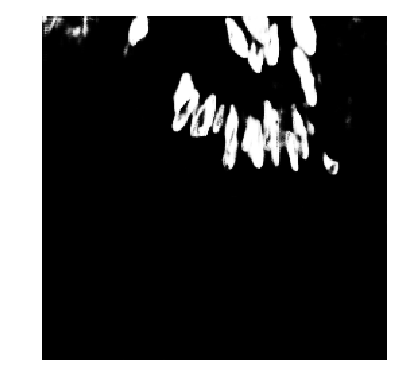

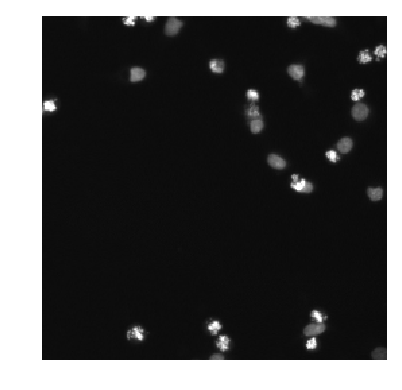

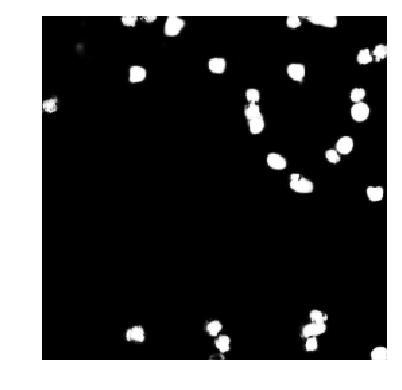

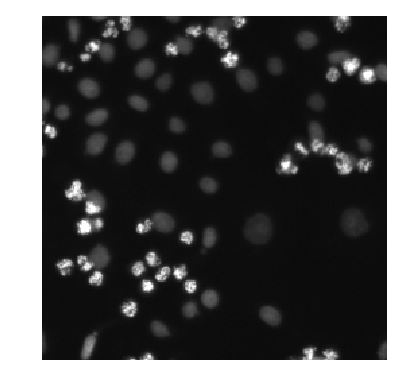

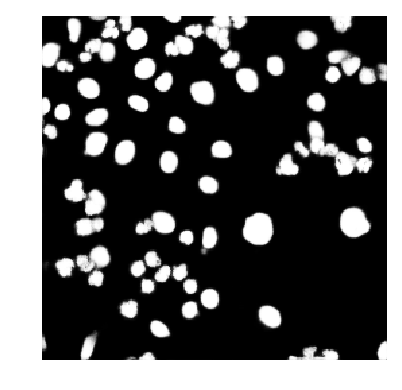

In [64]:
for ix in range(len(X_test)):


    imshow(X_test[ix],)
    plt.axis('off')
    plt.show()
    imshow(np.squeeze(preds_test)[ix])
    plt.axis('off')
    plt.show()

D:\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and


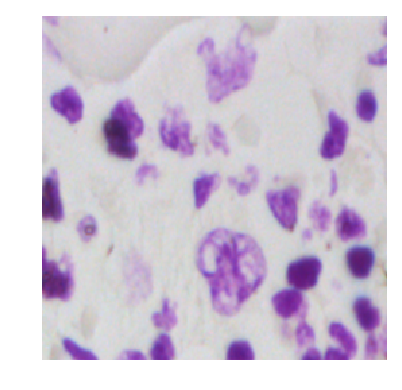

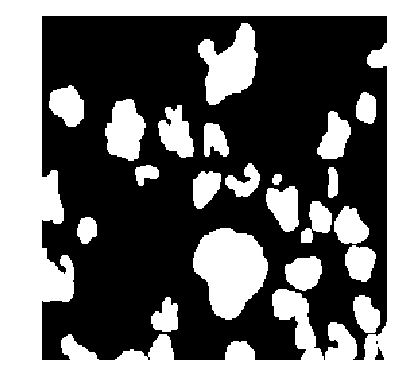

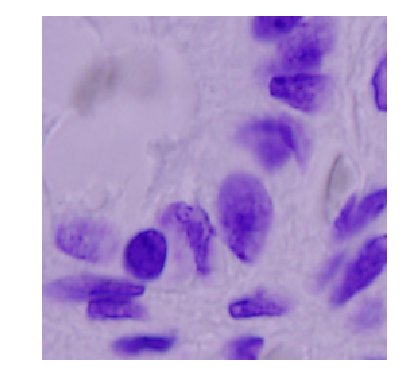

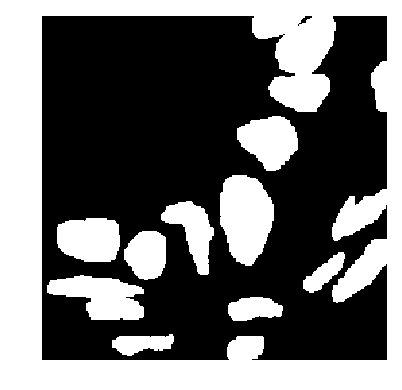

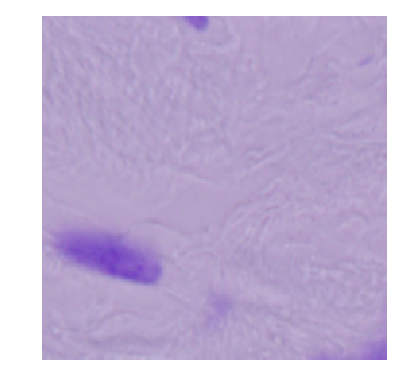

...

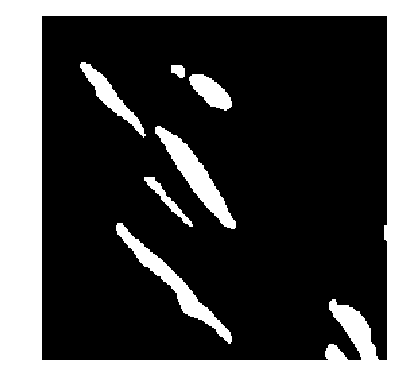

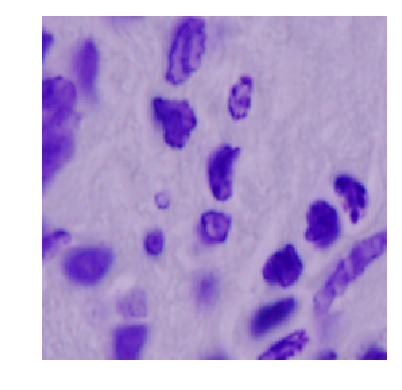

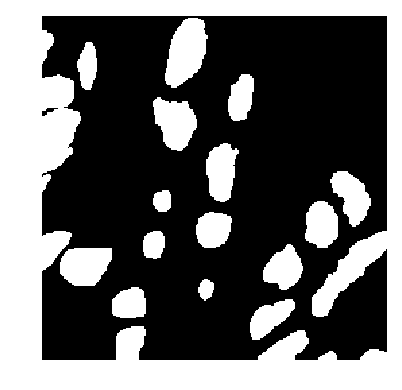

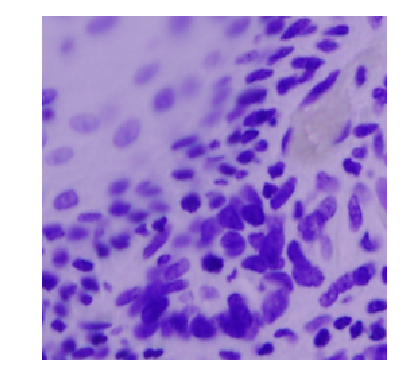

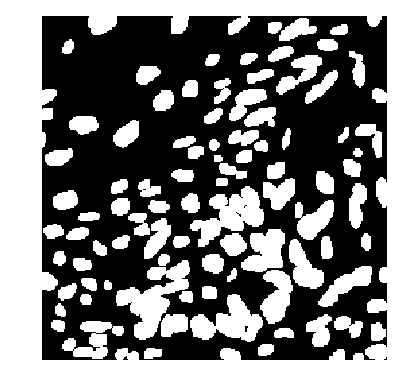

In [28]:
for ix in range(len(Y_train[90:int(X_train.shape[0]*1)])):

    imshow(X_train[90:int(X_train.shape[0]*1)][ix], cmap='gray')
    plt.axis('off')
    plt.show()
    imshow(np.squeeze(Y_train[90:int(X_train.shape[0]*1)][ix]))
    plt.axis('off')
    plt.show()

D:\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and


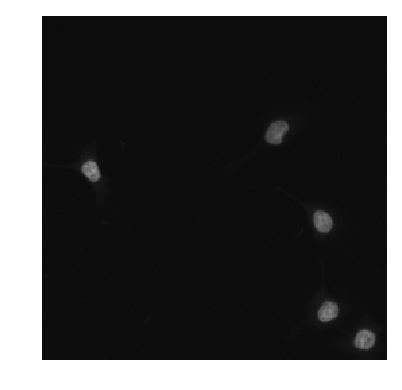

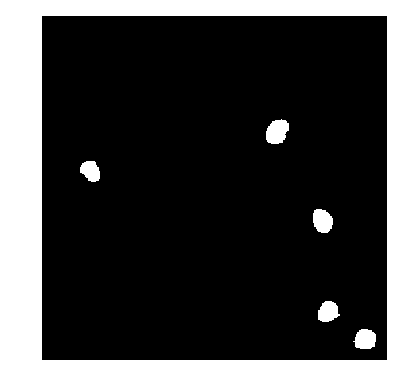

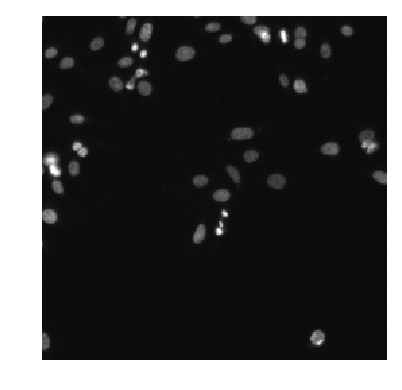

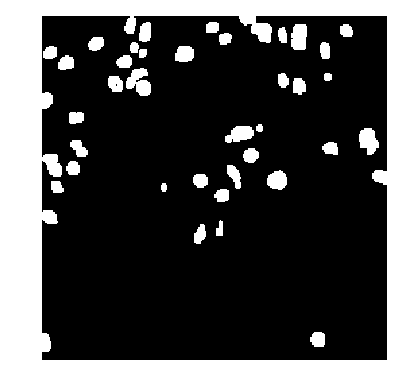

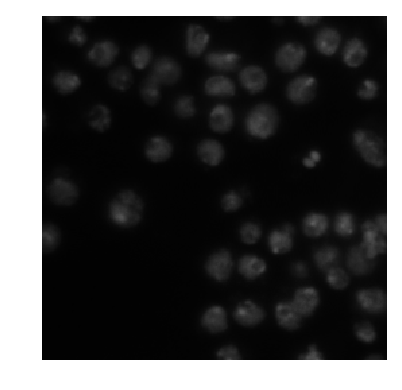

...

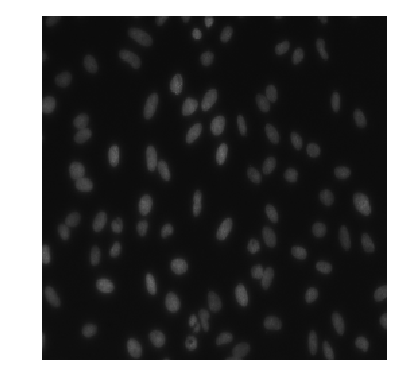

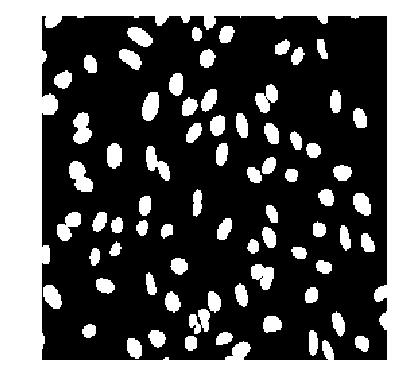

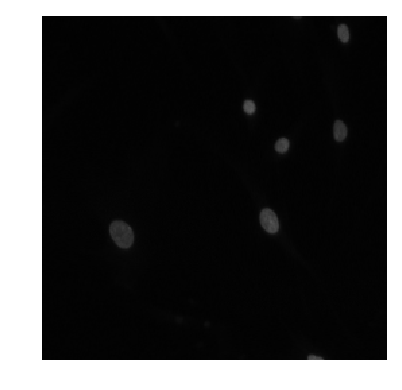

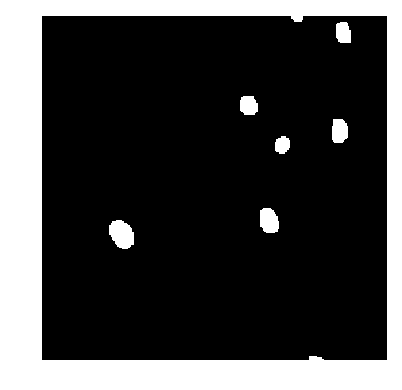

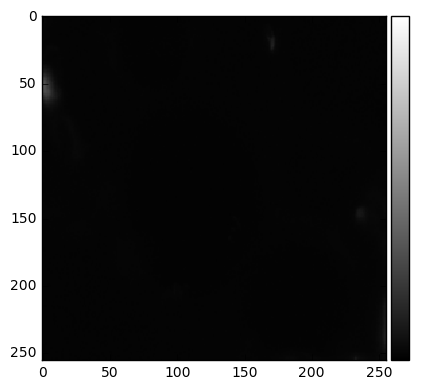

TypeError: numpy boolean subtract, the `-` operator, is deprecated, use the bitwise_xor, the `^` operator, or the logical_xor function instead.

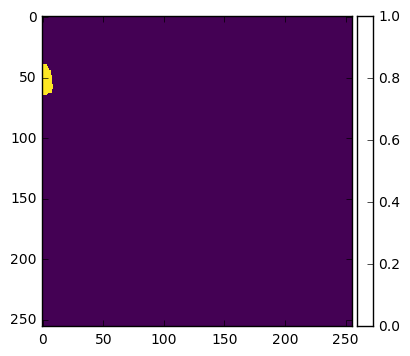

In [24]:
for ix in range(len(Y_trainn[25:int(X_trainn.shape[0]*0.99)])):

    imshow(X_trainn[25:int(X_trainn.shape[0]*0.99)][ix], cmap='gray')
    plt.axis('off')
    plt.show()
    imshow(np.squeeze(Y_trainn[25:int(X_trainn.shape[0]*0.99)][ix]))
    plt.axis('off')
    plt.show()

D:\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and


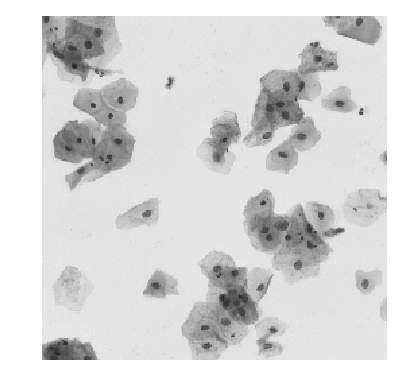

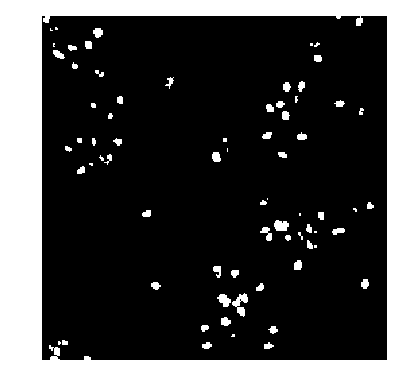

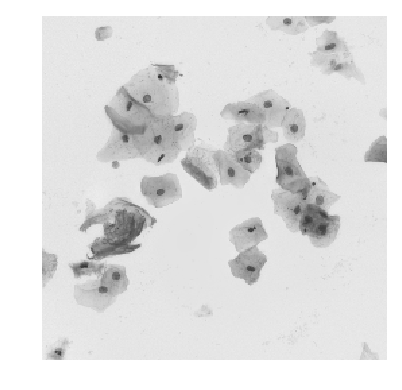

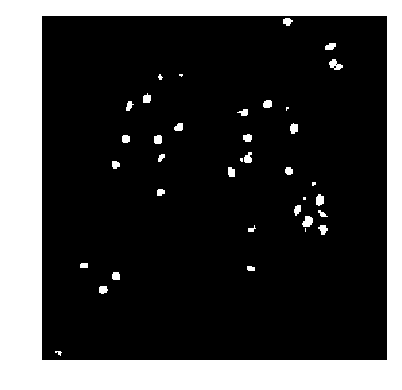

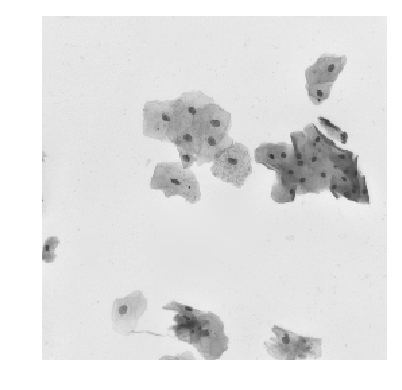

...

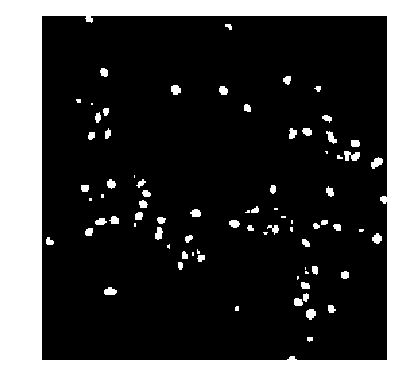

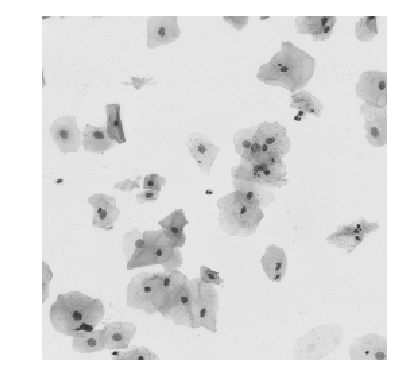

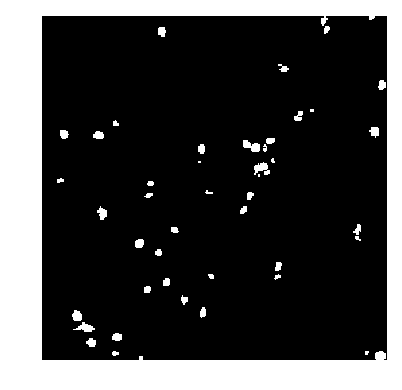

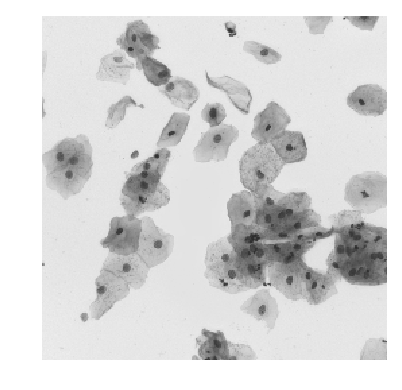

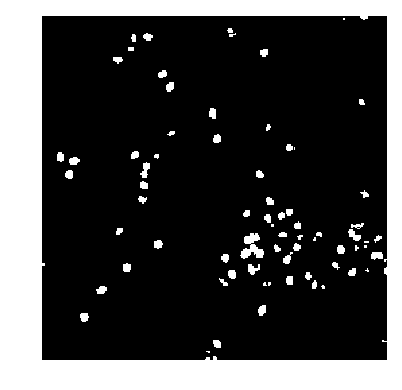

In [48]:
for ix in range(len(Y_trainnn[0:int(X_trainnn.shape[0]*1)])):

    imshow(X_trainnn[0:int(X_trainnn.shape[0]*1)][ix], cmap='gray')
    plt.axis('off')
    plt.show()
    imshow(np.squeeze(Y_trainnn[0:int(X_trainnn.shape[0]*1)][ix]))
    plt.axis('off')
    plt.show()

D:\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and


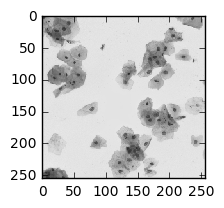

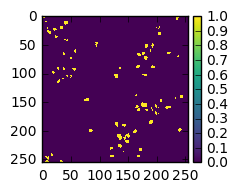

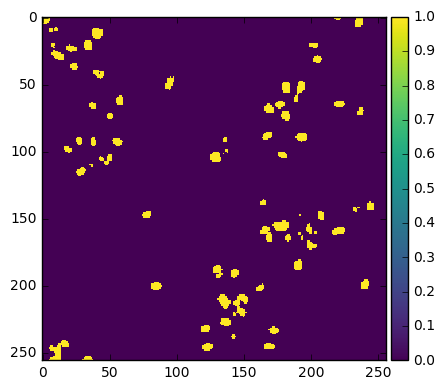

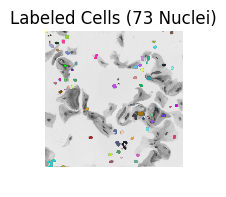

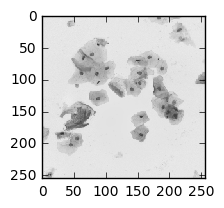

...

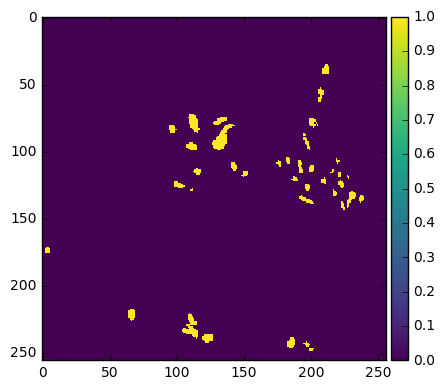

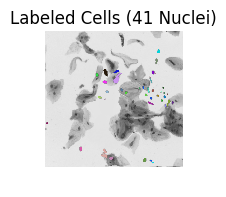

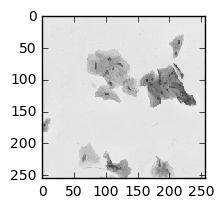

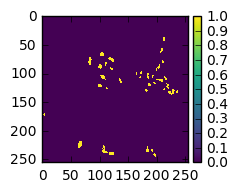

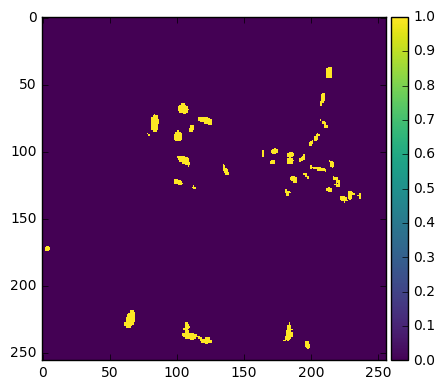

IndexError: index 143 is out of bounds for axis 0 with size 143

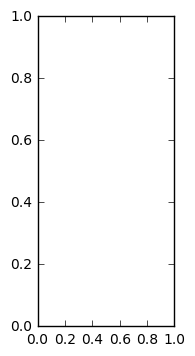

In [111]:
for ix in range(len(preds_train_tnn)):

    plt.subplot(131)
    imshow(X_trainnn[:int(X_trainnn.shape[0]*0.9)][ix], cmap='gray')
    plt.show()
    plt.subplot(132)
    imshow(np.squeeze(Y_trainnn[:int(X_trainnn.shape[0]*0.9)])[ix])
    plt.show()
    imshow(np.squeeze(preds_train_tnn)[ix])
    plt.show()
    from scipy import ndimage
    labels, nlabels = ndimage.label(np.squeeze(preds_train_tnn[ix]))

    label_arrays = []
    for label_num in range(1, nlabels+1):
        label_mask = np.where(labels == label_num, 1, 0)
        label_arrays.append(label_mask)
    # Create a random colormap
    from matplotlib.colors import ListedColormap
    rand_cmap = ListedColormap(np.random.rand(256,3))

    labels_for_display = np.where(labels > 0, labels, np.nan)
    plt.subplot(133)
    plt.imshow(X_trainnn[int(X_trainnn.shape[0]*0.9):][ix], cmap='gray')
    plt.imshow(labels_for_display, cmap=rand_cmap)
    plt.axis('off')
    plt.title('Labeled Cells ({} Nuclei)'.format(nlabels))
    plt.show()